# Load packages

In [1]:
# Loading the required packages to run this notebook
from src.visualisation.SummaryModels import SummaryModels
import src.utils.utils as utils
from src.visualisation.VisualiseTrajectories import VisualiseTrajectories
from src.data.Datasets import AISDataset
from pathlib import Path
import pandas as pd

# Define the region to look into
region = "Bornholm"
zoom = 8
n = 10

In [2]:
# Use the SummaryModels class for everything related to the reconstructions
file_name = "RegionBornholm_01062019_30092019_Fish_14400_86400_600"
generative_dist = "Diagonal"
learning_rate = 0.0001
scheduler_gamma = 0.5
scheduler_milestones = [350, 500, 800, 1200, 1500]

# Use the SummaryModels class
summary_models = SummaryModels(file_name, generative_dist=generative_dist, learning_rate=learning_rate,
                               scheduler_gamma=scheduler_gamma, scheduler_milestones=scheduler_milestones)

In [3]:
# Use the VisualiseTrajectories class for geographically visualising trajectories 
fig_size = (10, 10)
visualise_trajectories = VisualiseTrajectories(region, save_figures=False, plot_figures=True, fig_size=fig_size, zoom=zoom)
processed_data_dir =  visualise_trajectories.processed_data_dir

# Read the info file to know how to read the data file
data_file = processed_data_dir / ("data_" + file_name + ".pkl")
data_info_file = processed_data_dir / ("datasetInfo_" + file_name + ".pkl")
data_info = utils.read_data_info_file(data_info_file)

# Load the static Google Map image for the RIO
img = visualise_trajectories.read_static_map()

In [4]:
# Function that plots the actual and reconstructed side by side
def plot_actual_reconstructed(idx):
    # Setup for the plotting
    fig_size_tmp = visualise_trajectories.fig_size
    visualise_trajectories.fig_size = (20,10)
    fig, ax = visualise_trajectories.visualise_static_map(img, subplots=[1, 2])
    plot_figures_tmp = visualise_trajectories.plot_figures
    visualise_trajectories.plot_figures = False
        
    # For plotting a single complete vessel trajectory on the static map
    index = df_n.iloc[idx]["Index"]
    data_set = AISDataset(file_name, data_info=data_info, indicies=[index], discrete=False)
    df_actual = utils.get_tracks_from_dataset(data_set, continuous_representation=True)
    
    # For plotting the corresponding model reconstruction
    index = df_n.iloc[idx]["Data set Index"]
    data_set = train_evaluate.validation_dataloader.dataset
    reconstruction = train_evaluate.track_reconstructions(data_set, index)
    
    df_recon = reconstruction["Reconstruction"][2:]
    
    # Setup actual and reconstruction data frames
    df_speed = utils.concat_actual_recon(df_actual, df_recon, "Speed")
    df_course = utils.concat_actual_recon(df_actual, df_recon, "Course")
    
    # Do the actual plotting
    visualise_trajectories.plot_single_track(df_actual, ax[0], use_cmap=True, df_speed=df_speed,
                                                      df_course=df_course, fig=fig, rect=[0.15, 0.72, 0.12, 0.12], 
                                                      rect2=[0.575, 0.72, 0.12, 0.12])
    visualise_trajectories.plot_figures = plot_figures_tmp
    visualise_trajectories.plot_single_track(df_recon, ax[1], use_cmap=True)
    visualise_trajectories.fig_size = fig_size_tmp
    return {"Actual trajectory": df_actual, "Reconstructed trajectory": df_recon,
            "Speed data frame": df_speed, "Course data frame": df_course}

# Fishing Reconstruction Example

In [5]:
# Get some trajectories to show an example from 
data = summary_models.run_evaluation_get_n(n=100, worst=False)
df_n = data["TrajectoryLevelData"]
train_evaluate = data["TrainEvaluateObject"]

C:\Github\vessel-trajectory-anomaly-detection\models\saved-models\VRNN_RegionBornholm_01062019_30092019_Fish_14400_86400_600_latent100_recurrent100_batchNormFalse_Diagonal_lr00001_S35050080012001500_05.pth


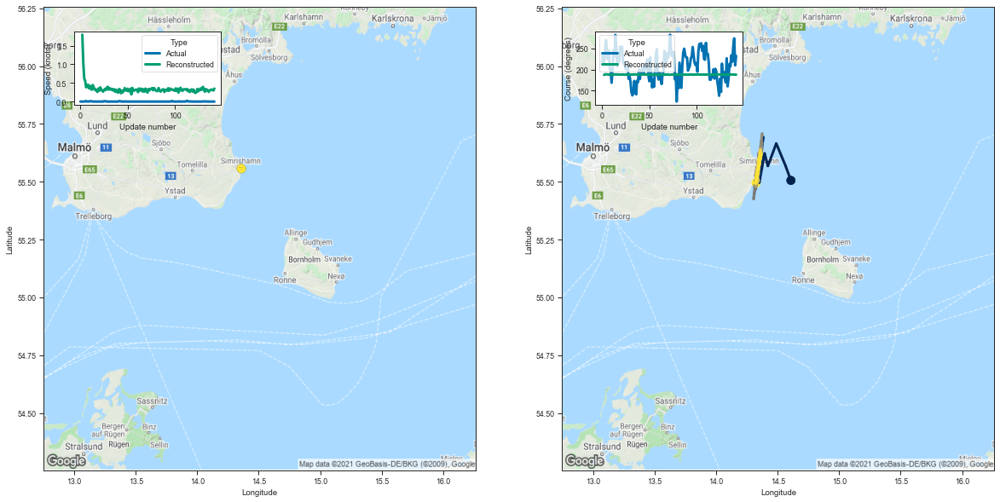

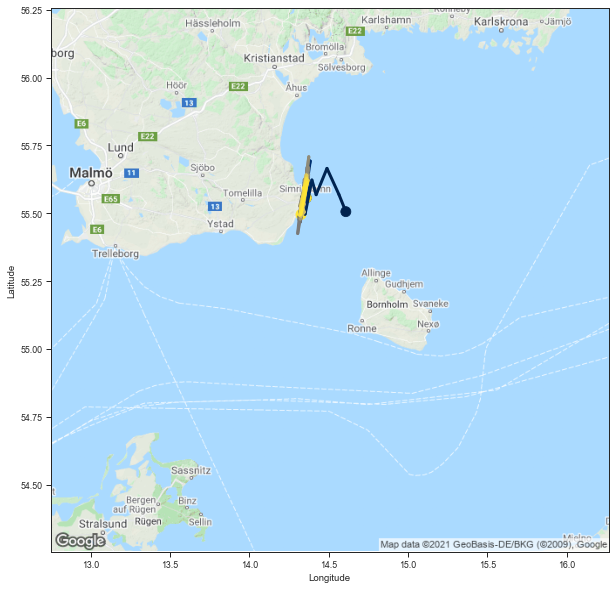

     Data set Index    Index       MMSI  Longitude   Latitude     Speed  \
0                 0  6685896  265759000  14.359031  55.556702  0.000000   
1                 0  6685896  265759000  14.359023  55.556713  0.000000   
2                 0  6685896  265759000  14.359054  55.556709  0.001923   
3                 0  6685896  265759000  14.359044  55.556709  0.000000   
4                 0  6685896  265759000  14.359061  55.556709  0.003571   
..              ...      ...        ...        ...        ...       ...   
138               0  6685896  265759000  14.359066  55.556721  0.000000   
139               0  6685896  265759000  14.359043  55.556709  0.000000   
140               0  6685896  265759000  14.359036  55.556713  0.000000   
141               0  6685896  265759000  14.359025  55.556694  0.000000   
142               0  6685896  265759000  14.359023  55.556709  0.000000   

         Course Ship type  Track length          Time stamp  
0    219.074280   Fishing           1

,Longitude,Latitude,Speed,Course,Longitude sigma,Latitude sigma,Speed sigma,Course sigma
2,14.607894,55.505783,1.798027,187.029587,0.225975,0.104528,1.900507,100.722497
3,14.564406,55.569092,1.055676,188.586823,0.126836,0.063978,1.430387,101.758378
4,14.489073,55.665379,0.621240,188.426651,0.087114,0.058059,1.175077,101.818217
5,14.420853,55.568230,0.560045,188.196472,0.078109,0.055075,1.136393,101.692206
6,14.394203,55.622459,0.382312,188.179535,0.069772,0.057129,1.038824,101.703719
...,...,...,...,...,...,...,...,...
138,14.343347,55.588226,0.311434,188.050903,0.061359,0.054112,0.971386,101.670846
139,14.340835,55.592251,0.324777,187.989548,0.061499,0.055092,0.997308,101.690055
140,14.364482,55.614716,0.311031,188.096497,0.063025,0.052496,0.997709,101.715630
141,14.332349,55.512798,0.296837,187.818451,0.062658,0.053015,0.979698,101.556793


In [6]:
# Plot the actual and reconstructed trajectories side by side
tracks = plot_actual_reconstructed(3)

# Plot them on the same figure
visualise_trajectories.fig_size = fig_size
plot_figures_tmp = visualise_trajectories.plot_figures
fig, ax = visualise_trajectories.visualise_static_map(img)
visualise_trajectories.plot_figures = False
visualise_trajectories.plot_single_track(tracks["Actual trajectory"], ax, use_cmap=True)
visualise_trajectories.plot_figures = plot_figures_tmp
visualise_trajectories.plot_single_track(tracks["Reconstructed trajectory"], ax, use_cmap=True)

print(tracks['Actual trajectory'])
tracks['Reconstructed trajectory']

# Best Fishing Reconstructions

C:\Github\vessel-trajectory-anomaly-detection\models\saved-models\VRNN_RegionBornholm_01062019_30092019_Fish_14400_86400_600_latent100_recurrent100_batchNormFalse_Diagonal_lr00001_S35050080012001500_05.pth


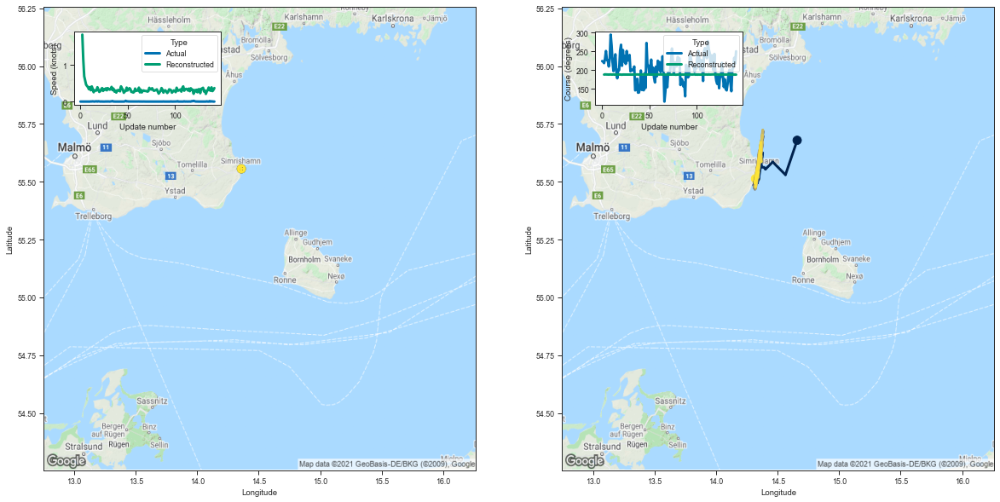

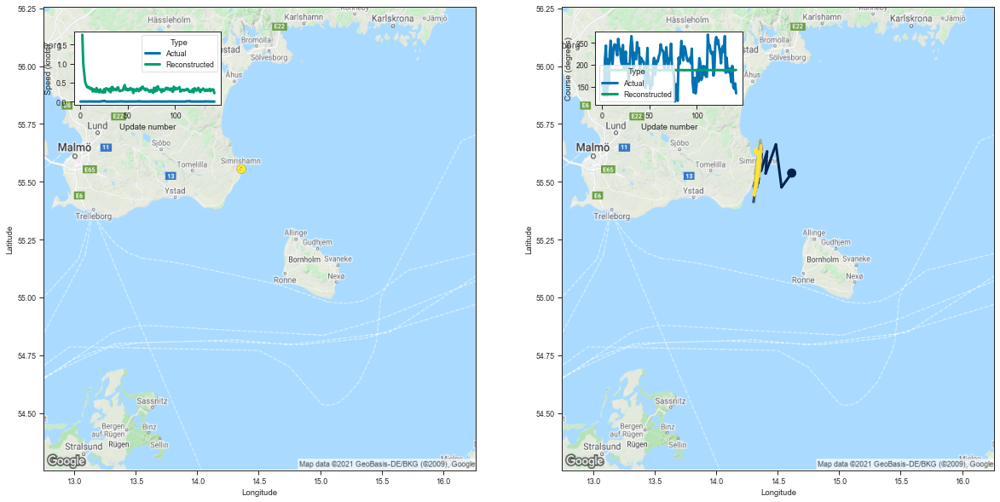

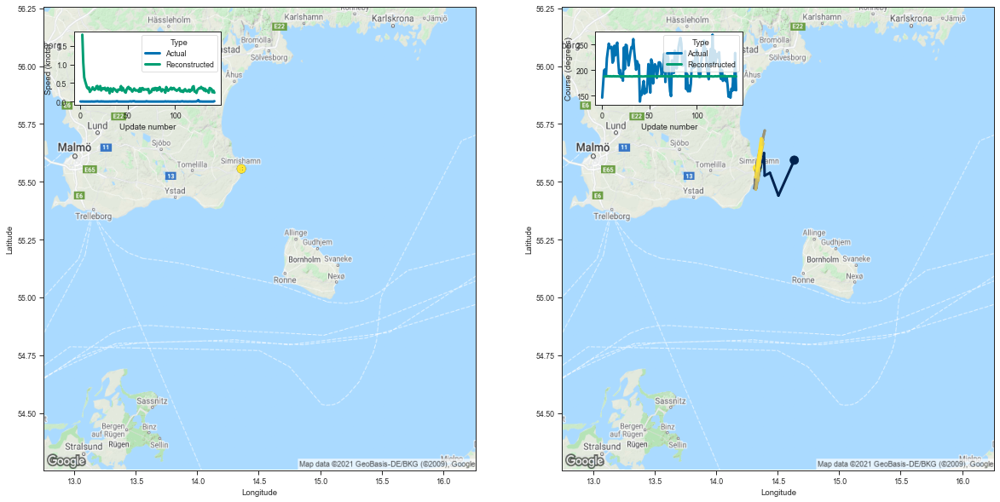

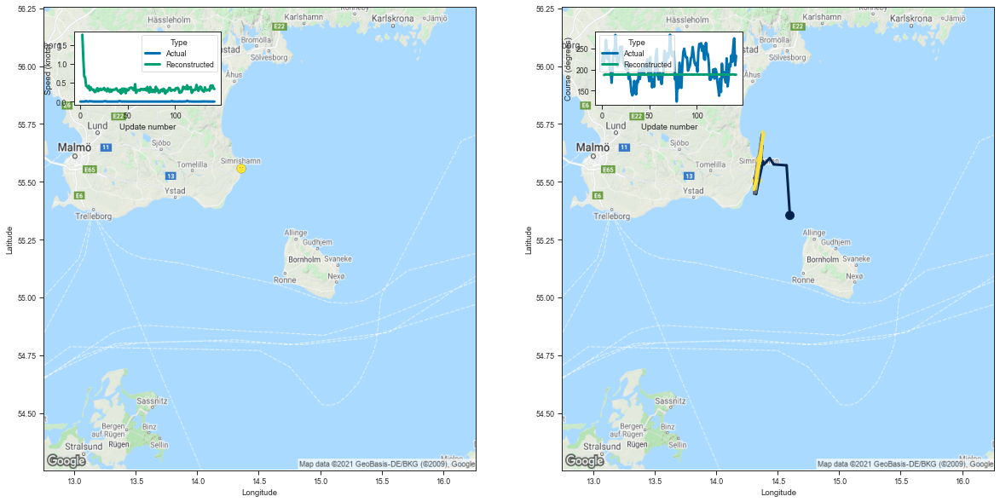

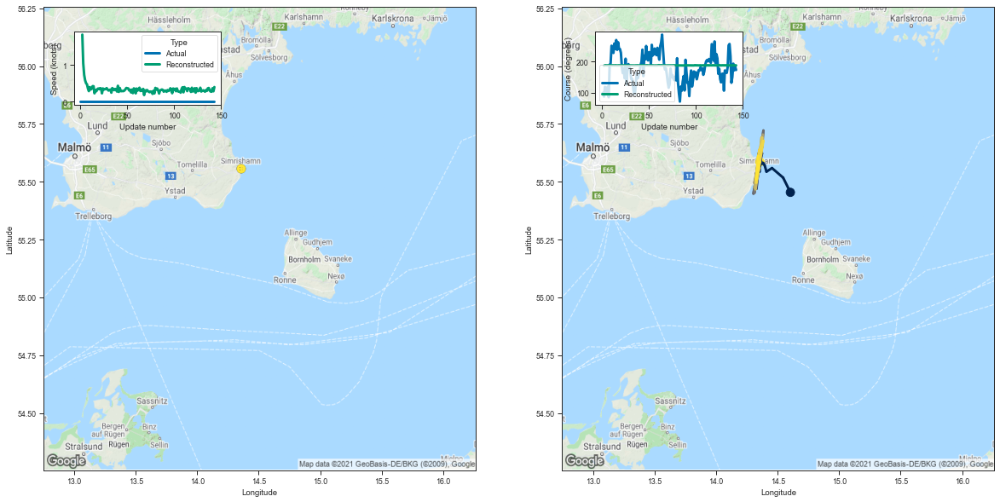

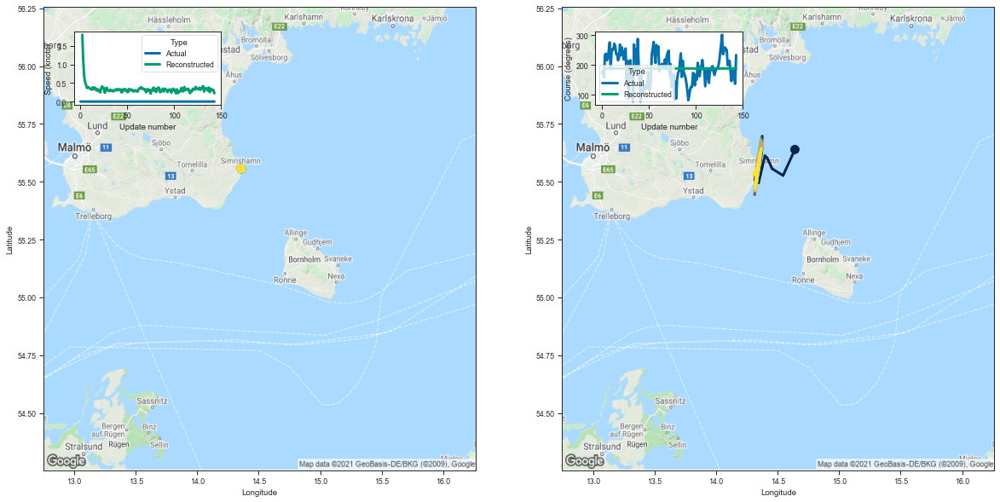

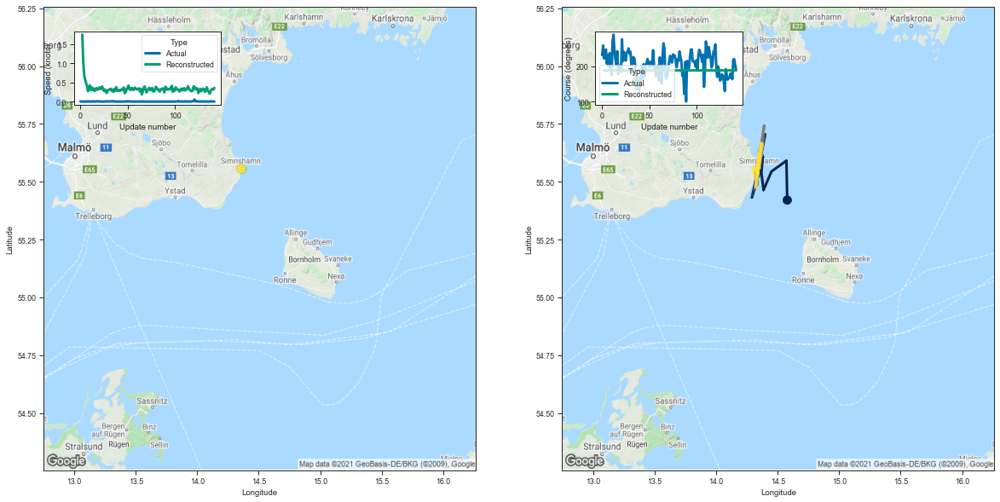

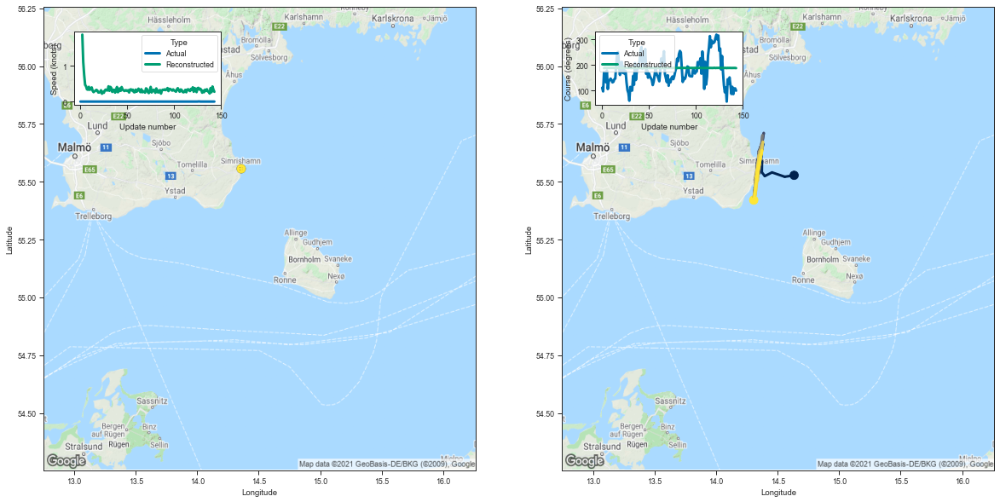

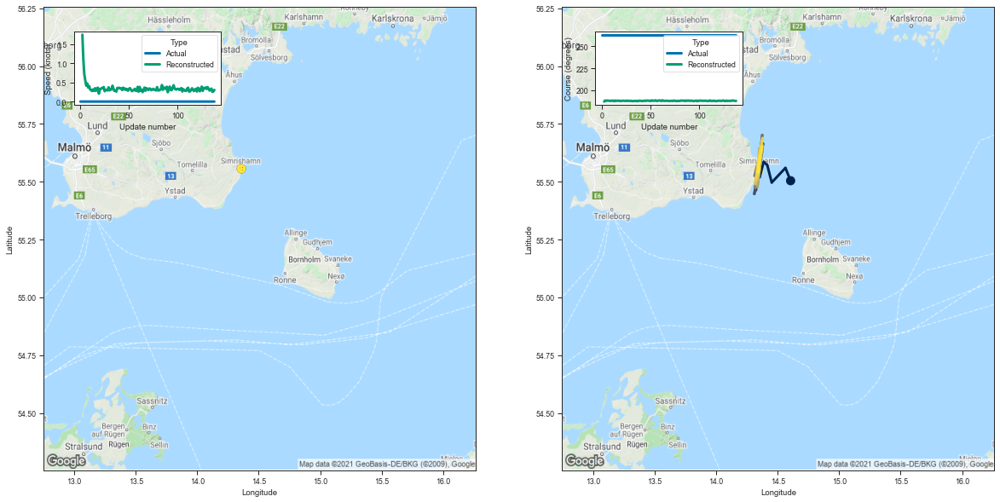

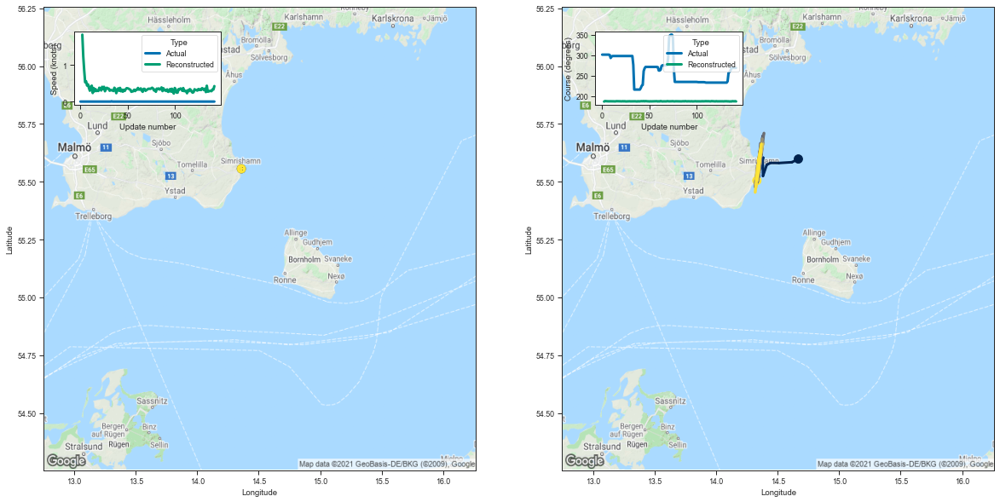

,Data set Index,Index,MMSI,Ship type,Length,Reconstruction log probability,Equally weighted reconstruction log probability
29,29,6787151,265759000,Fishing,143,-486.715759,-3.403607
74,74,6962046,265759000,Fishing,143,-487.663330,-3.410233
60,60,6869996,265759000,Fishing,143,-491.402557,-3.436382
17,17,6685896,265759000,Fishing,143,-494.630280,-3.458953
25,25,7292936,266054000,Fishing,144,-499.496613,-3.468726
44,44,7135380,266054000,Fishing,144,-504.023804,-3.500165
95,95,6805561,265759000,Fishing,143,-503.109131,-3.518246
34,34,7237328,266054000,Fishing,144,-510.100494,-3.542365
43,43,5760657,265750000,Fishing,139,-501.921326,-3.610945
103,103,6064863,265754000,Fishing,143,-524.281189,-3.666302


In [7]:
# Focus on the n best cargo reconstructions
data = summary_models.run_evaluation_get_n(n=n, worst=False)
df_n = data["TrajectoryLevelData"]
train_evaluate = data["TrainEvaluateObject"]

# Plot the actual and reconstructed trajectories side by side
for idx in range(n): 
    tracks = plot_actual_reconstructed(idx)
df_n

# Worst Fishing Reconstructions

C:\Github\vessel-trajectory-anomaly-detection\models\saved-models\VRNN_RegionBornholm_01062019_30092019_Fish_14400_86400_600_latent100_recurrent100_batchNormFalse_Diagonal_lr00001_S35050080012001500_05.pth


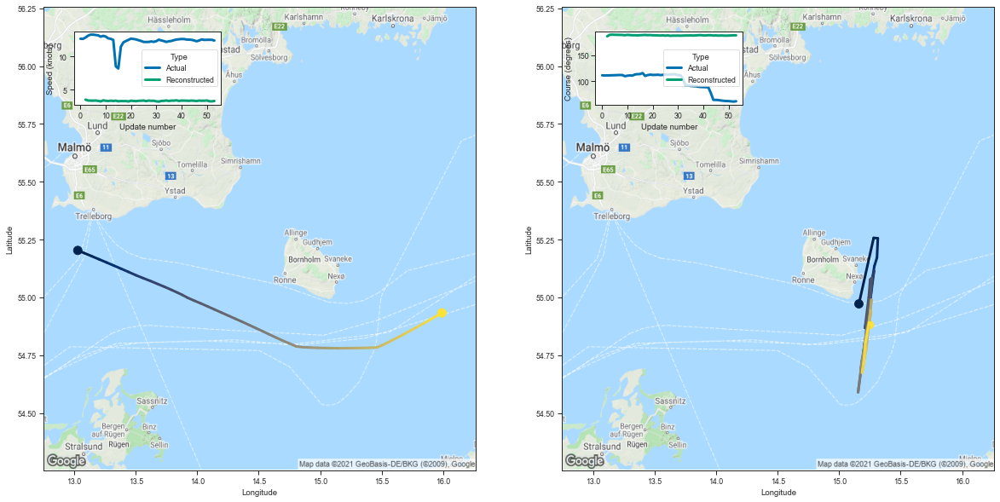

[3.467280864715576, 3.3367786407470703, 3.322422981262207, 3.311723232269287]


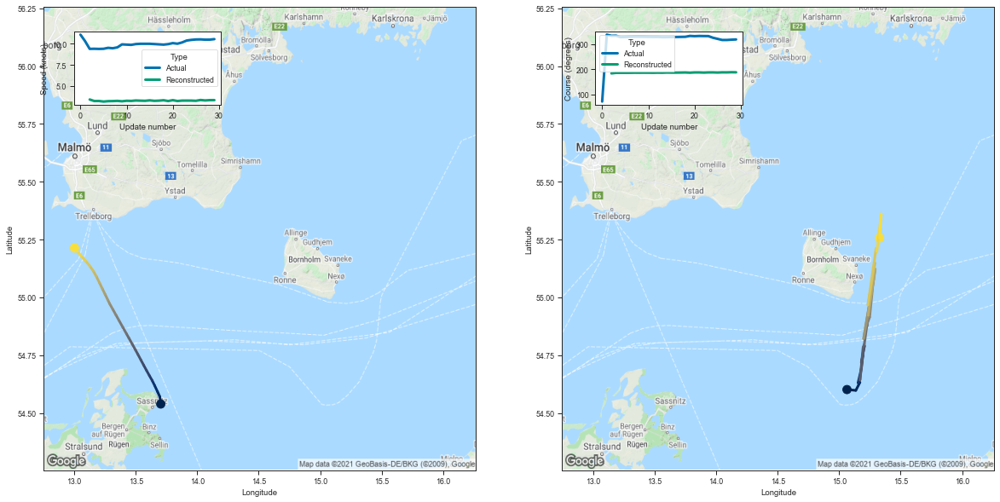

[3.4191317558288574, 3.2392921447753906, 3.244232177734375, 3.1752405166625977]


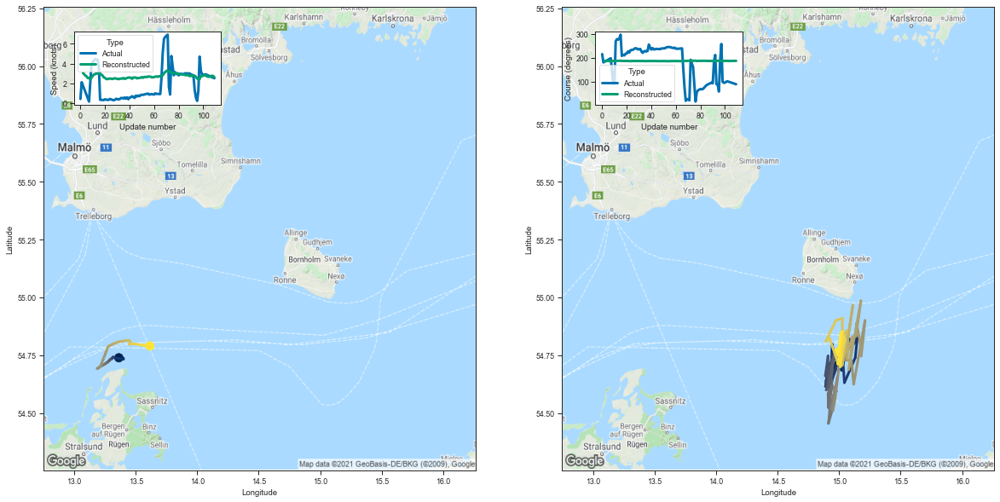

[3.053830146789551, 2.9177374839782715, 2.770209312438965, 2.691122055053711]


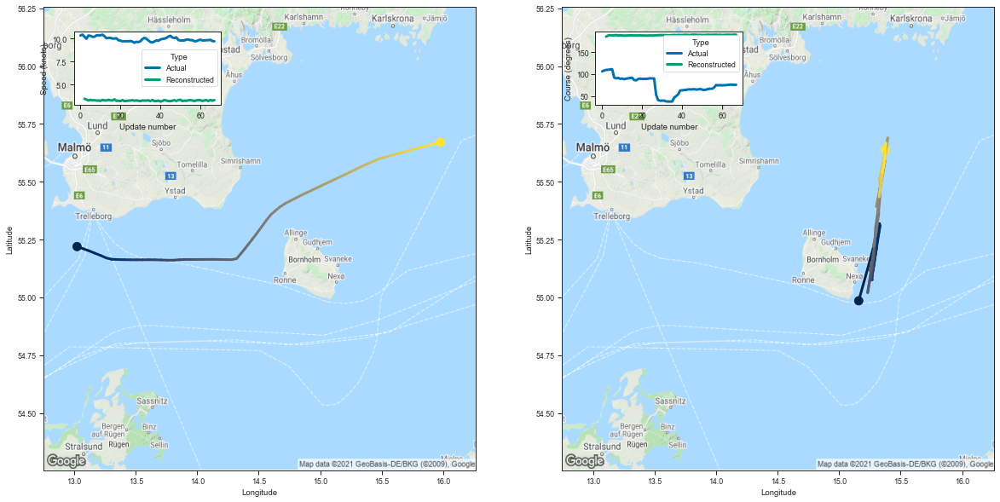

[3.4511046409606934, 3.361697196960449, 3.2628631591796875, 3.3356852531433105]


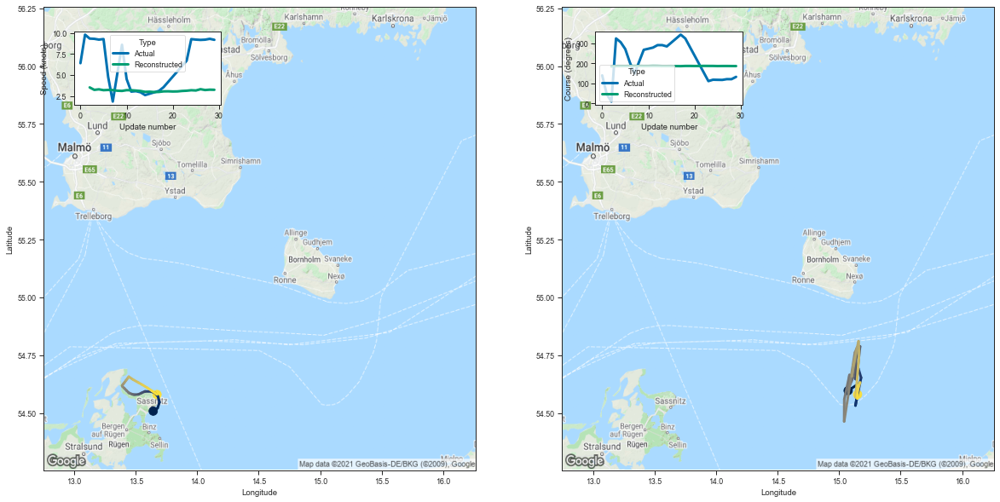

[3.514636516571045, 3.2220335006713867, 3.2869138717651367, 3.186189651489258]


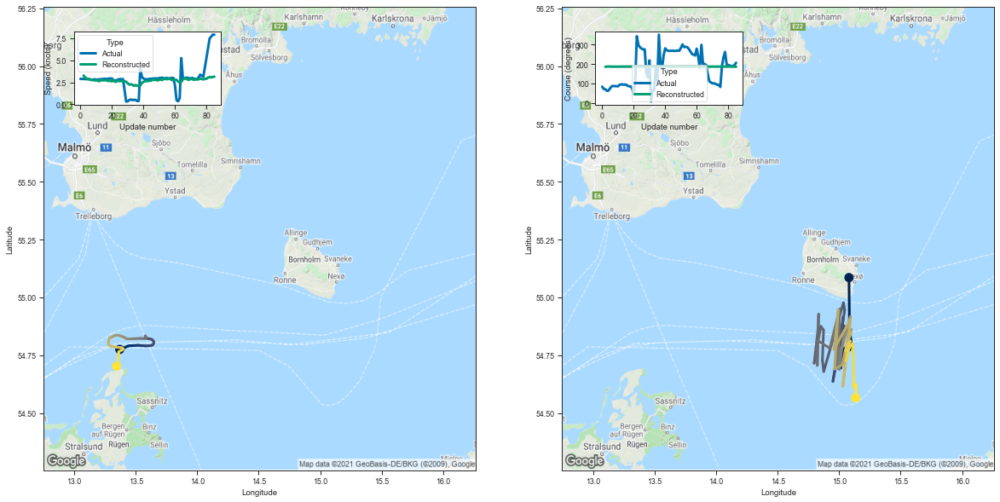

[3.2716622352600098, 3.041016101837158, 2.9234933853149414, 2.8566036224365234]


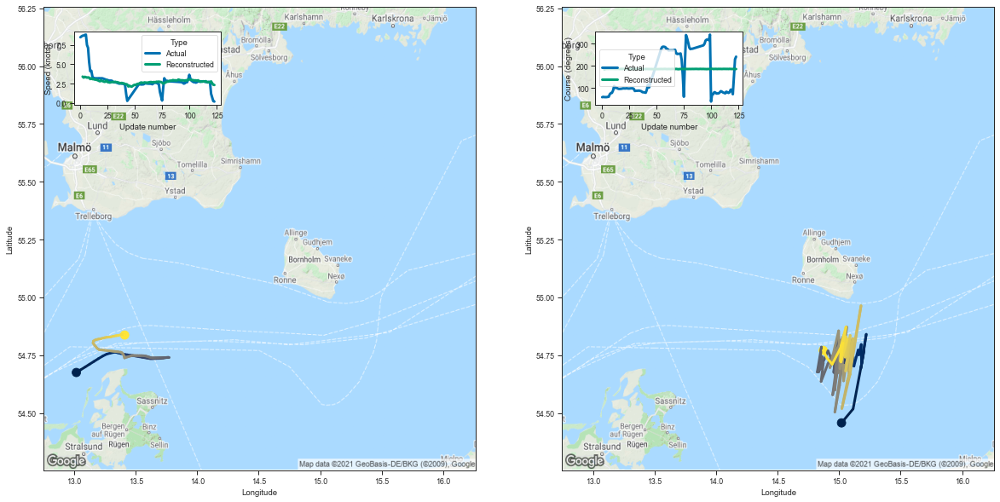

[3.4155454635620117, 3.2879371643066406, 3.3877077102661133, 3.343790054321289]


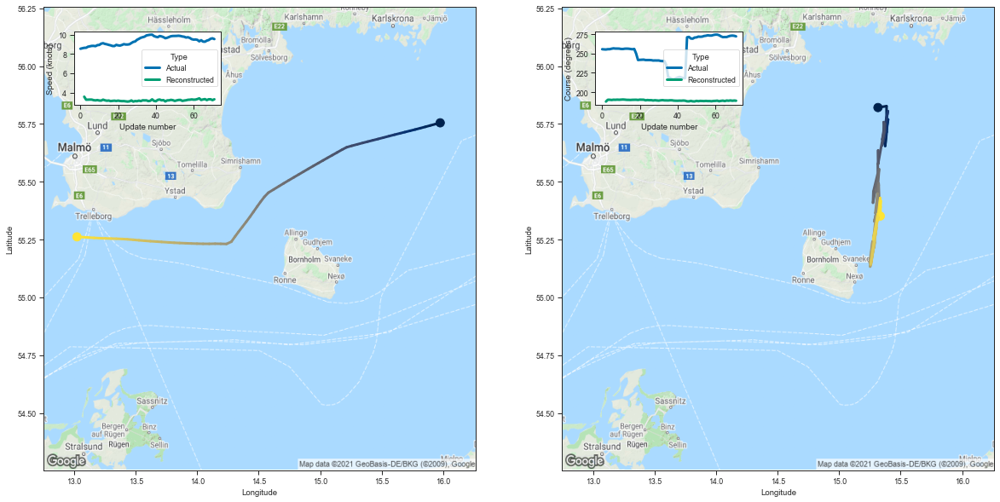

[3.5801267623901367, 3.2681593894958496, 3.271320343017578, 3.2815356254577637]


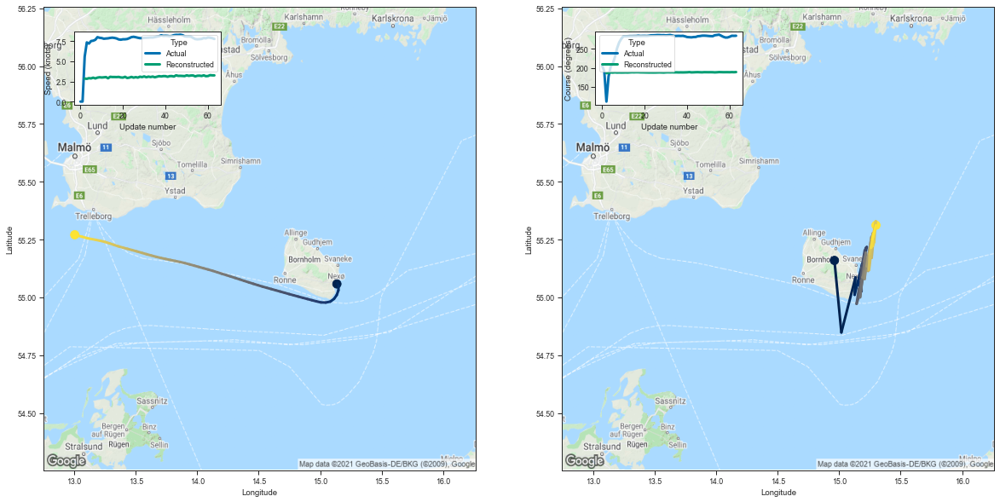

[2.859768867492676, 2.826735019683838, 2.906010627746582, 2.8795247077941895]


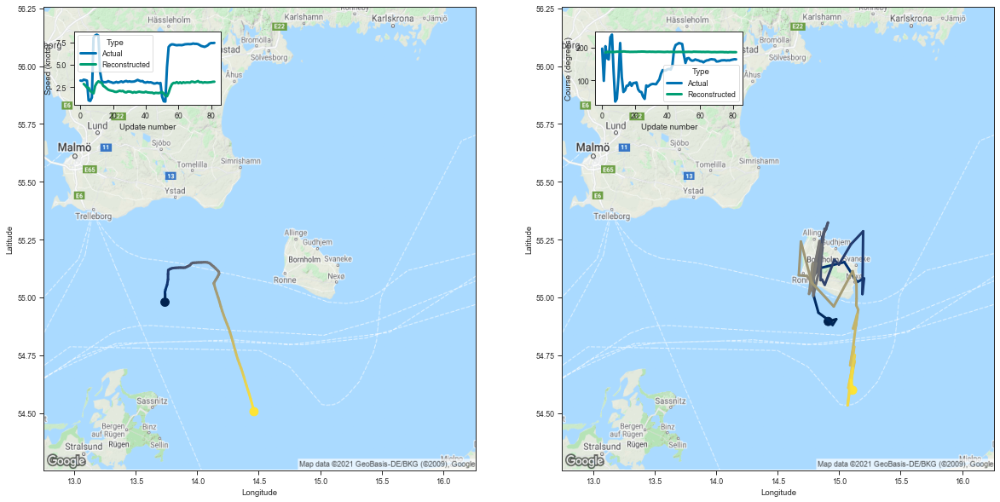

[2.846909999847412, 2.6721506118774414, 2.437155246734619, 2.400604248046875]


,Data set Index,Index,MMSI,Ship type,Length,Reconstruction log probability,Equally weighted reconstruction log probability
36,36,7969192,273352230,Fishing,54,-725.988831,-13.444238
101,101,1176042,211755650,Fishing,30,-392.061829,-13.068728
21,21,19488,211243240,Fishing,110,-1351.500977,-12.286373
97,97,7993496,273513600,Fishing,68,-768.166992,-11.296573
73,73,1113112,211542610,Fishing,30,-334.118530,-11.137284
90,90,32291,211243240,Fishing,86,-957.512024,-11.133861
2,2,295372,211314800,Fishing,124,-1371.475830,-11.060289
6,6,7960421,273294000,Fishing,72,-762.181885,-10.585860
37,37,1615516,220339000,Fishing,64,-668.497314,-10.445271
7,7,3067071,261002520,Fishing,83,-814.579895,-9.814216


In [8]:
# Focus on the n worst cargo reconstructions
data = summary_models.run_evaluation_get_n(n=n, worst=True)
df_n = data["TrajectoryLevelData"]
train_evaluate = data["TrainEvaluateObject"]

# Plot the actual and reconstructed trajectories side by side
for idx in range(n): 
    tracks = plot_actual_reconstructed(idx)
    print(list(tracks["Reconstructed trajectory"]["Speed"])[:4])
df_n

# Best 100 Reconstructions

C:\Github\vessel-trajectory-anomaly-detection\models\saved-models\VRNN_RegionBornholm_01062019_30092019_Fish_14400_86400_600_latent100_recurrent100_batchNormFalse_Isotropic_Gaussian_lr5e-05.pth


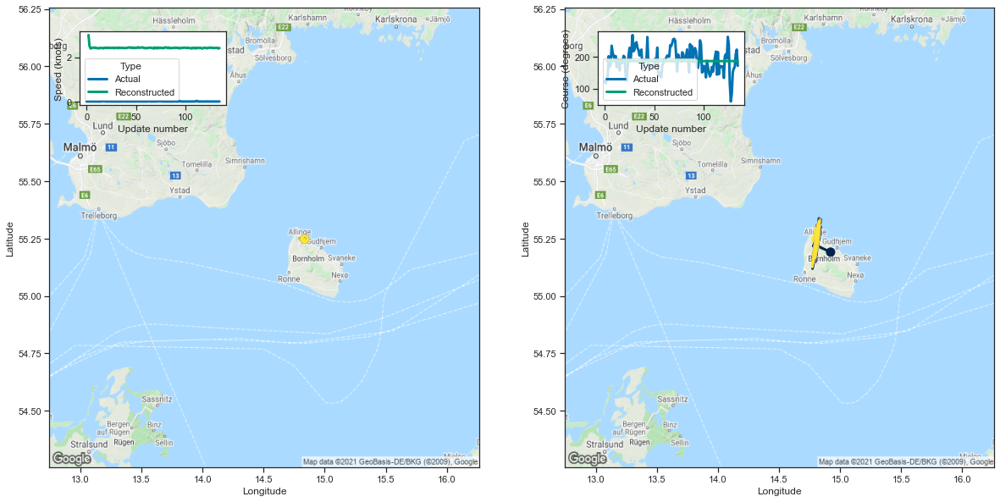

[3.0102221965789795, 2.517970561981201, 2.401482105255127, 2.410270929336548]


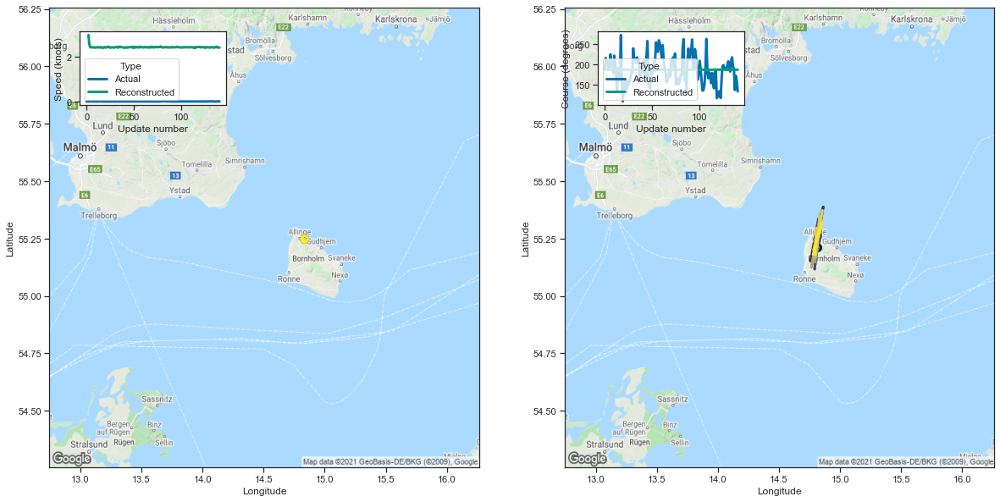

[2.9725308418273926, 2.5453033447265625, 2.4201881885528564, 2.4286508560180664]


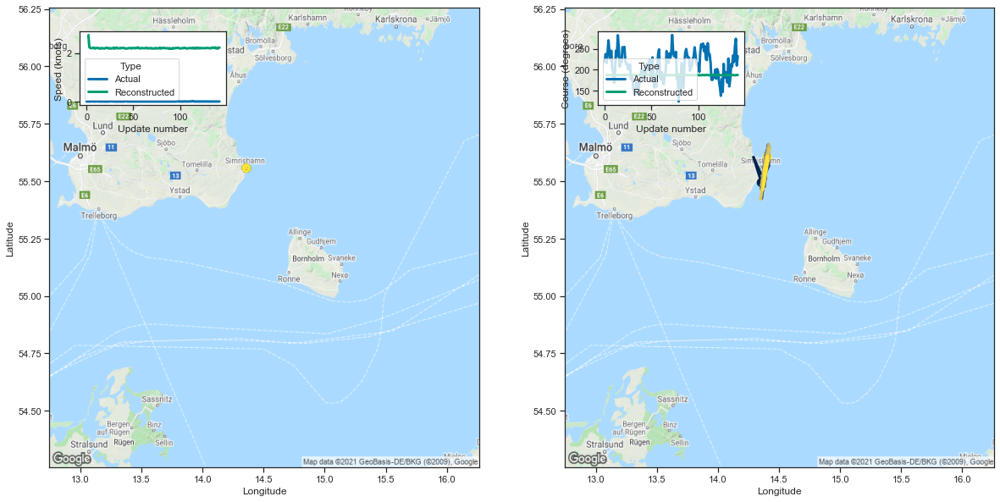

[2.749847412109375, 2.2445454597473145, 2.2168257236480713, 2.2002148628234863]


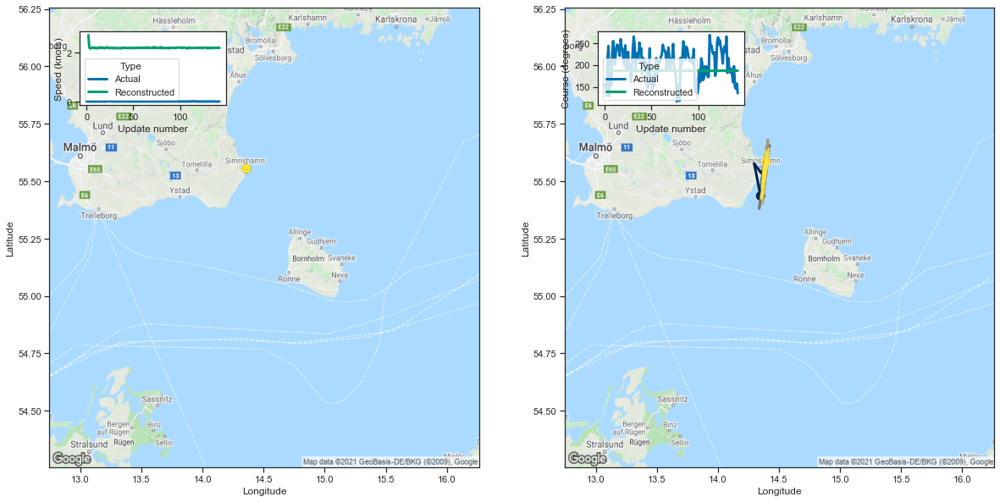

[2.73517107963562, 2.2217602729797363, 2.1810202598571777, 2.2046473026275635]


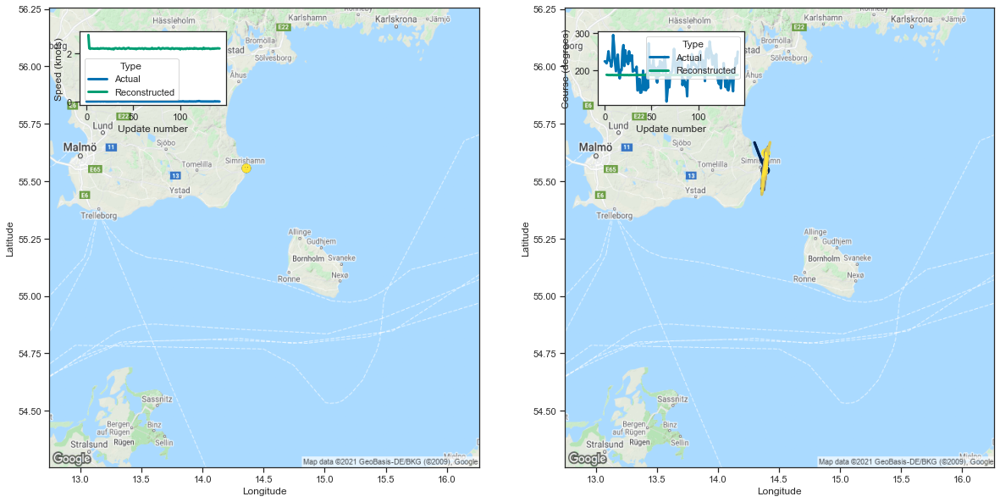

[2.768503427505493, 2.2148330211639404, 2.1941487789154053, 2.2141342163085938]


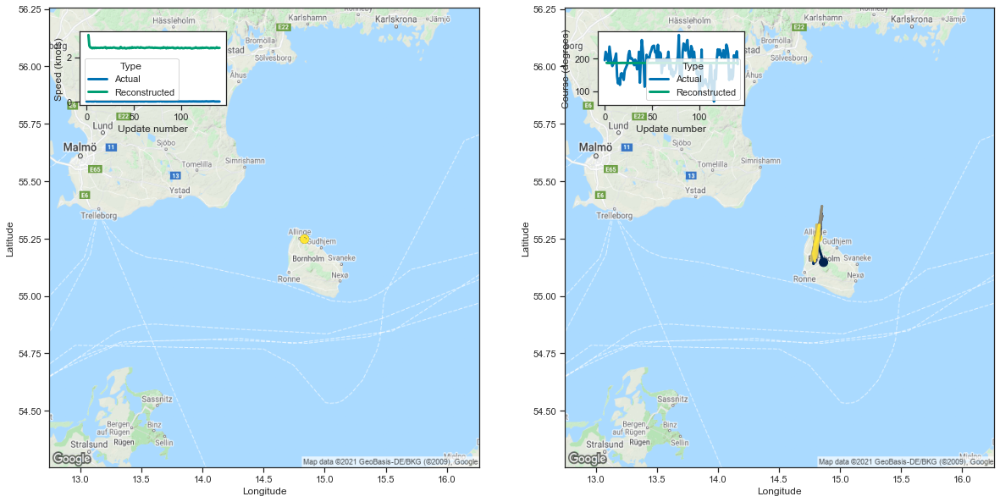

[3.0034563541412354, 2.5198099613189697, 2.443037509918213, 2.4286677837371826]


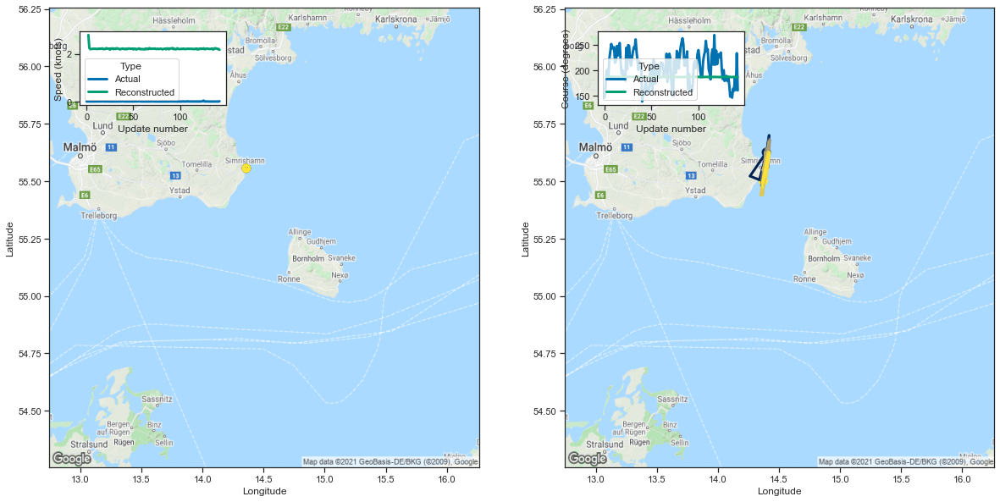

[2.785403251647949, 2.240849494934082, 2.193451166152954, 2.2009007930755615]


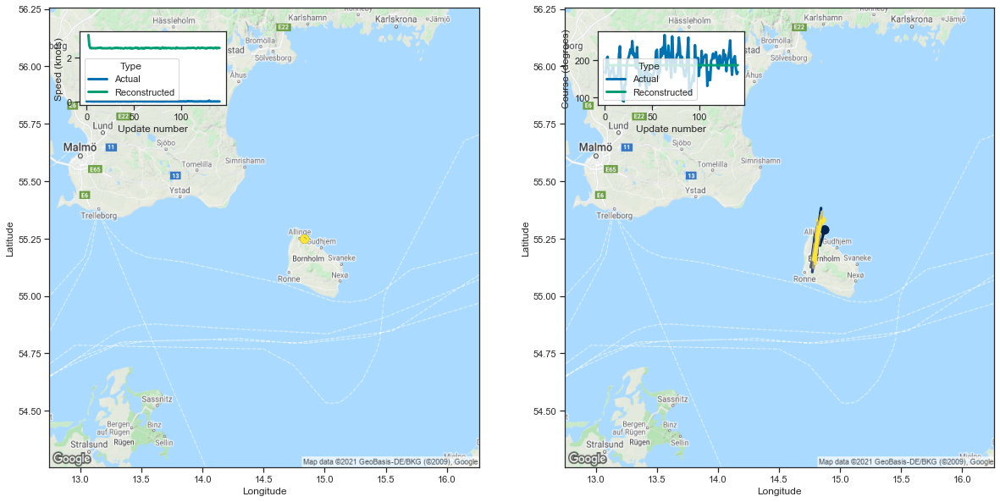

[3.018319606781006, 2.534019947052002, 2.428062915802002, 2.4142403602600098]


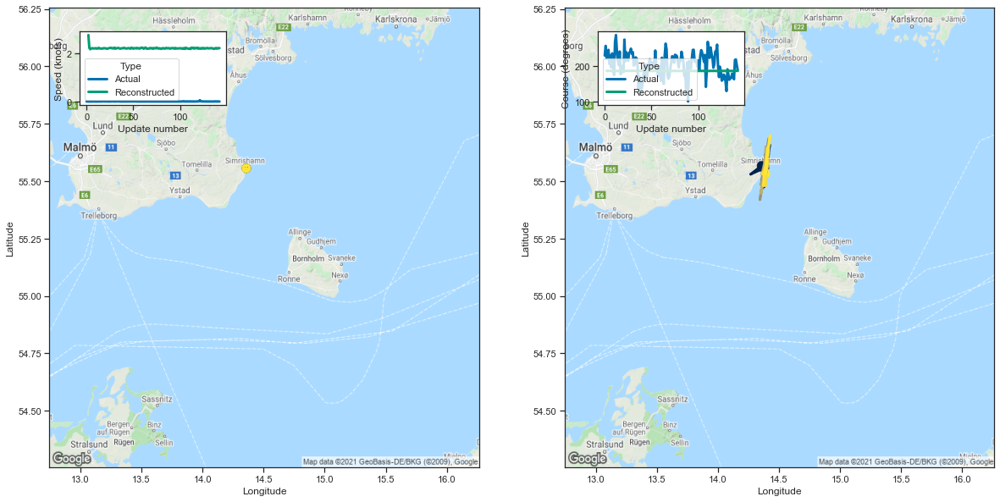

[2.757833957672119, 2.2256970405578613, 2.1691884994506836, 2.203545093536377]


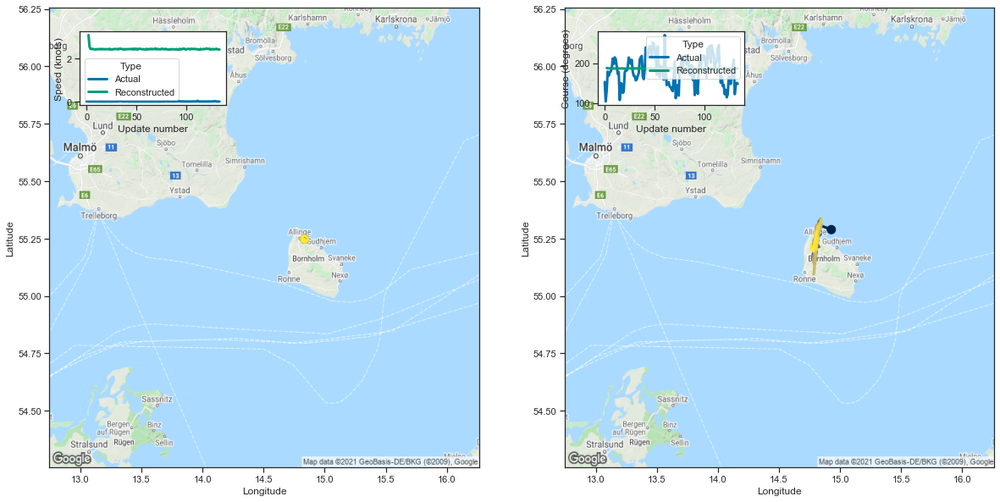

[3.082245111465454, 2.5423786640167236, 2.4363813400268555, 2.4335594177246094]


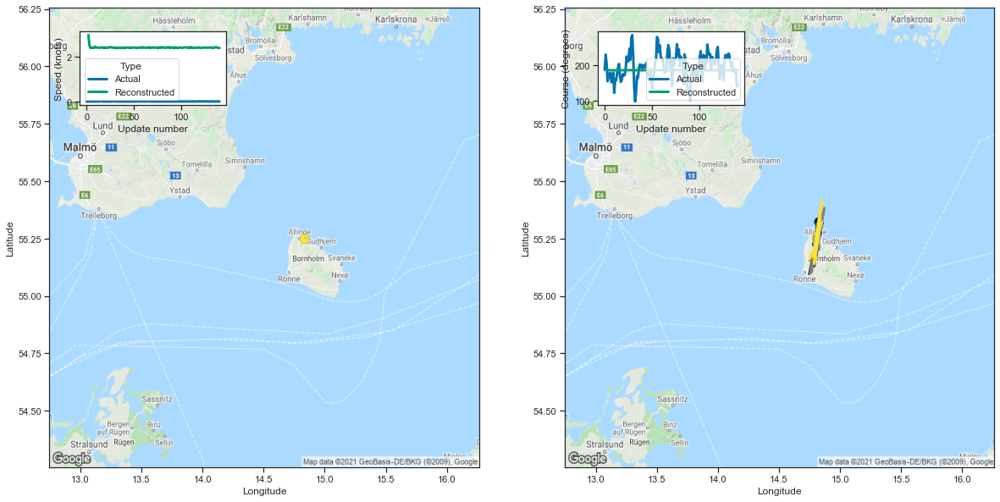

[2.995926856994629, 2.5534439086914062, 2.4225783348083496, 2.411170482635498]


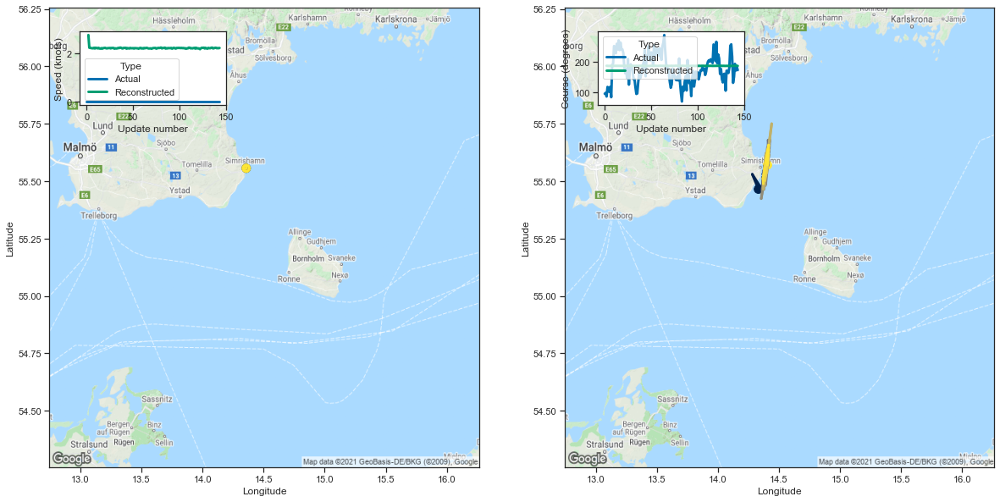

[2.7519736289978027, 2.225346088409424, 2.2245442867279053, 2.2086305618286133]


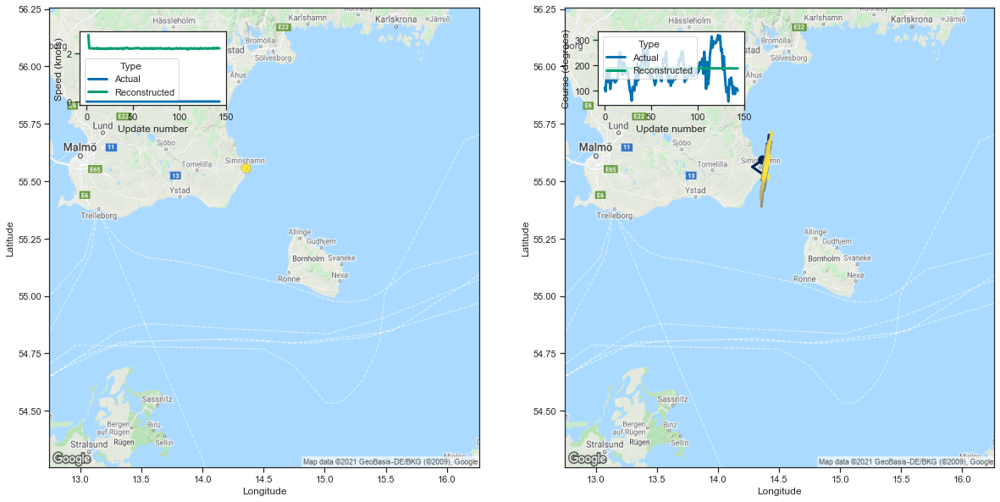

[2.7692105770111084, 2.2239885330200195, 2.2104218006134033, 2.216536521911621]


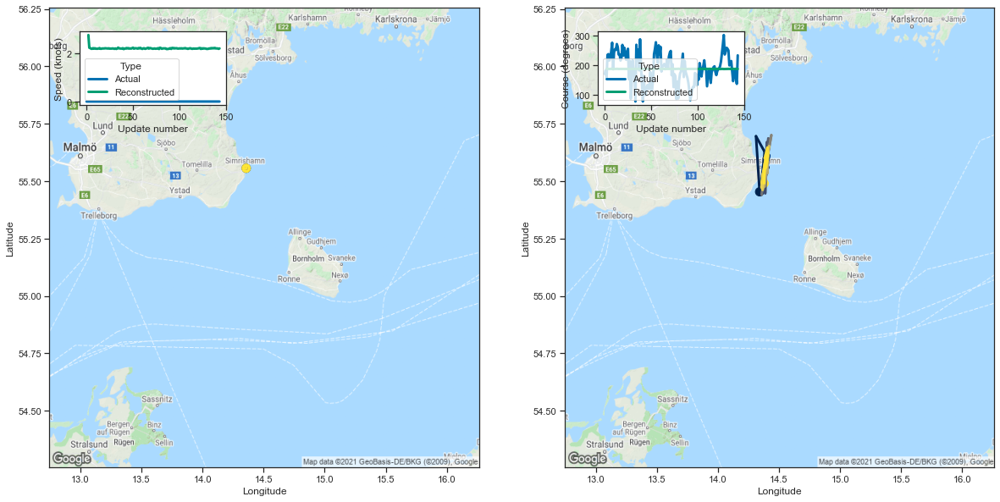

[2.766343832015991, 2.2377467155456543, 2.2232065200805664, 2.195578098297119]


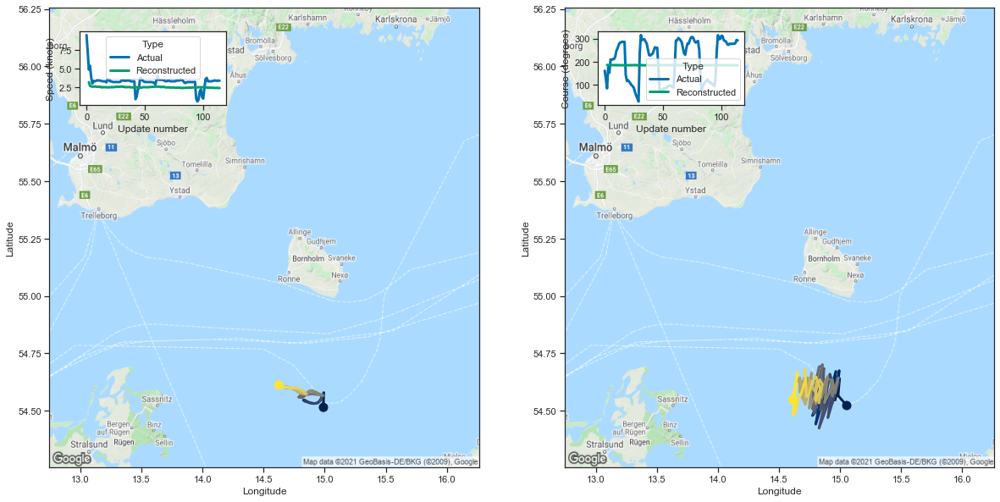

[3.180164337158203, 2.6739256381988525, 2.628113269805908, 2.5755181312561035]


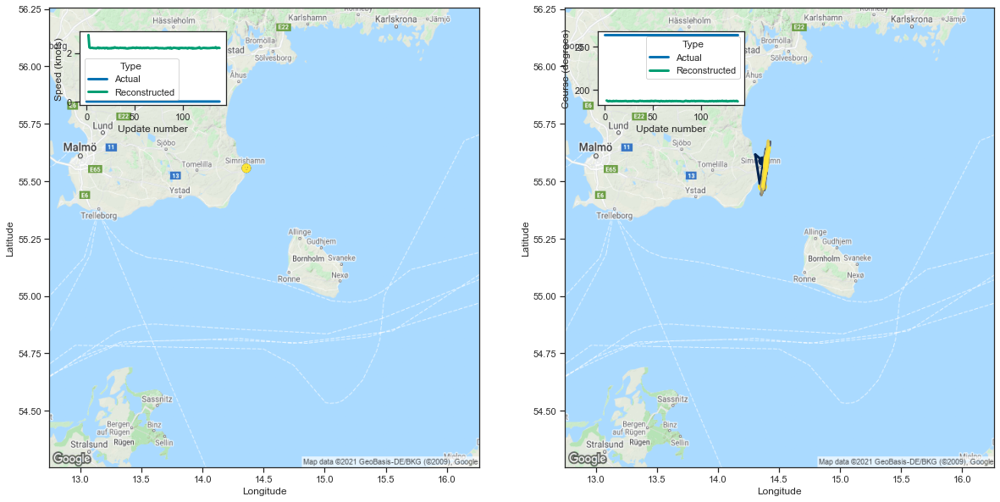

[2.7433974742889404, 2.2354657649993896, 2.2083027362823486, 2.2141809463500977]


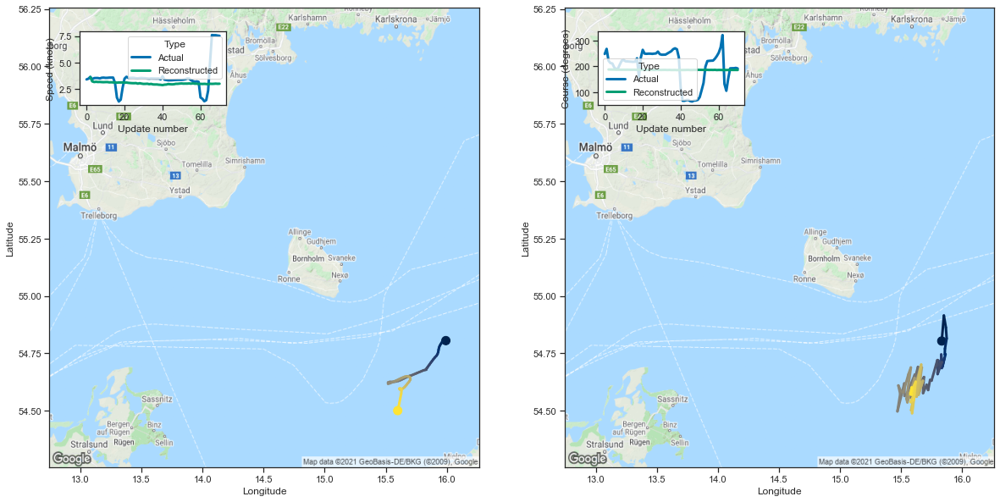

[3.6421608924865723, 3.2442665100097656, 3.1838929653167725, 3.205066442489624]


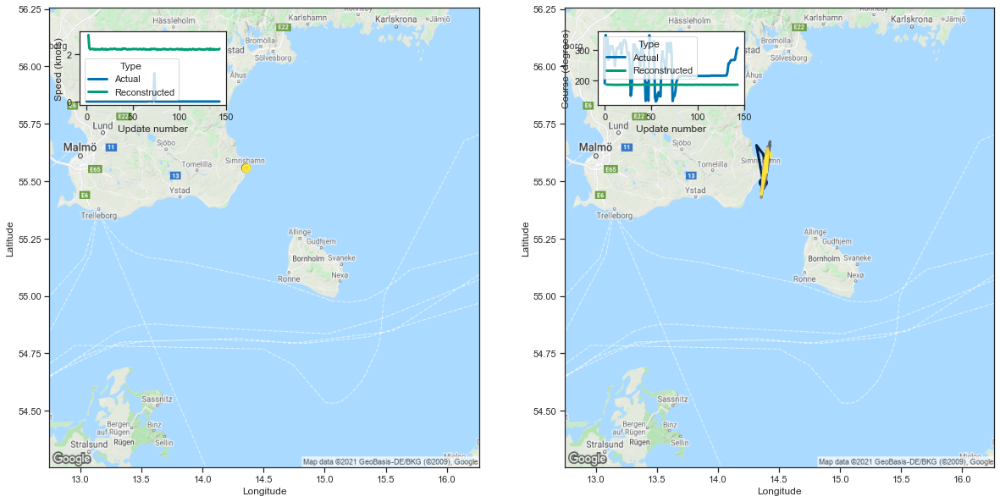

[2.807389497756958, 2.2596380710601807, 2.204364538192749, 2.214524984359741]


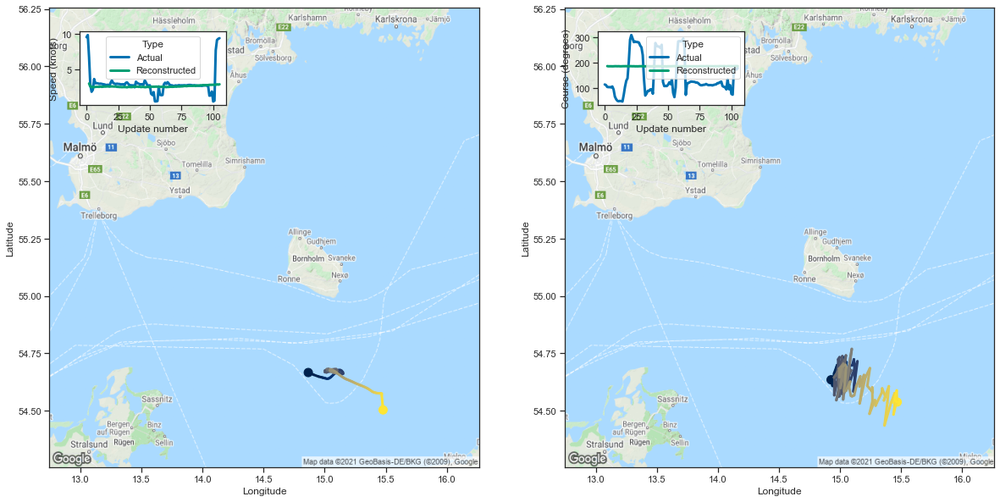

[3.082540988922119, 2.662856101989746, 2.5632617473602295, 2.5942013263702393]


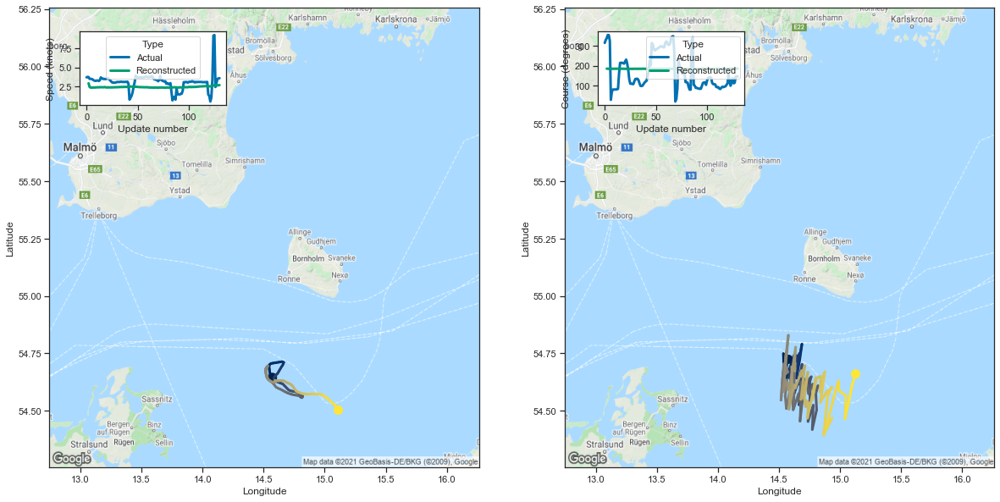

[2.9301037788391113, 2.4450173377990723, 2.3654069900512695, 2.3573429584503174]


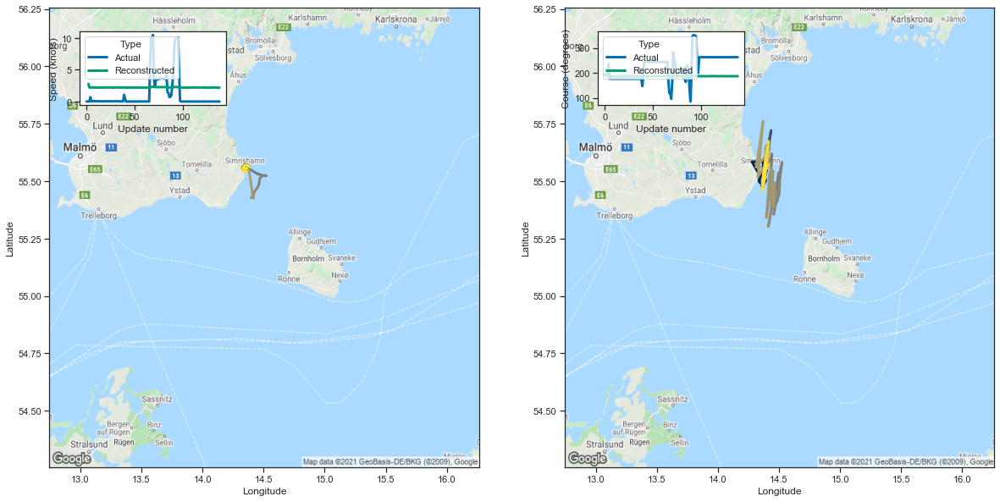

[2.780212640762329, 2.2106430530548096, 2.199841260910034, 2.201613664627075]


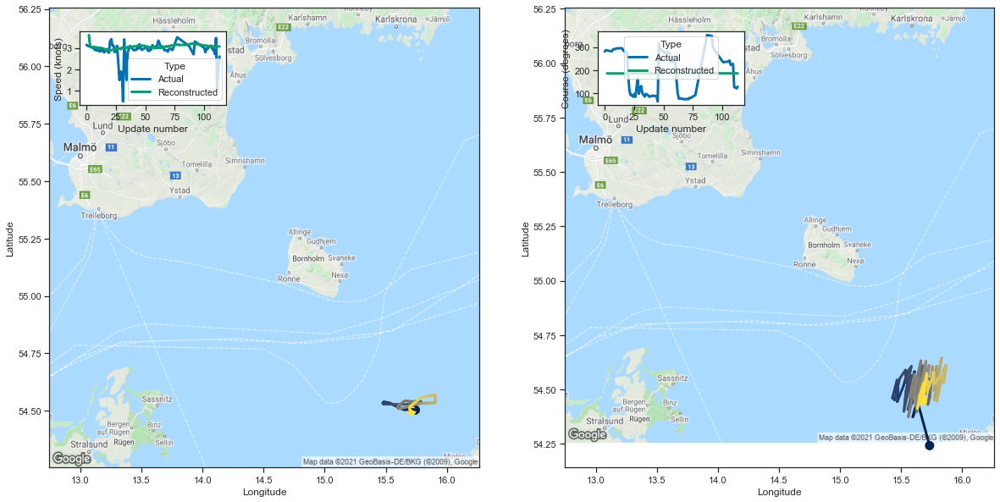

[3.6033565998077393, 3.104401111602783, 3.026078701019287, 3.047381639480591]


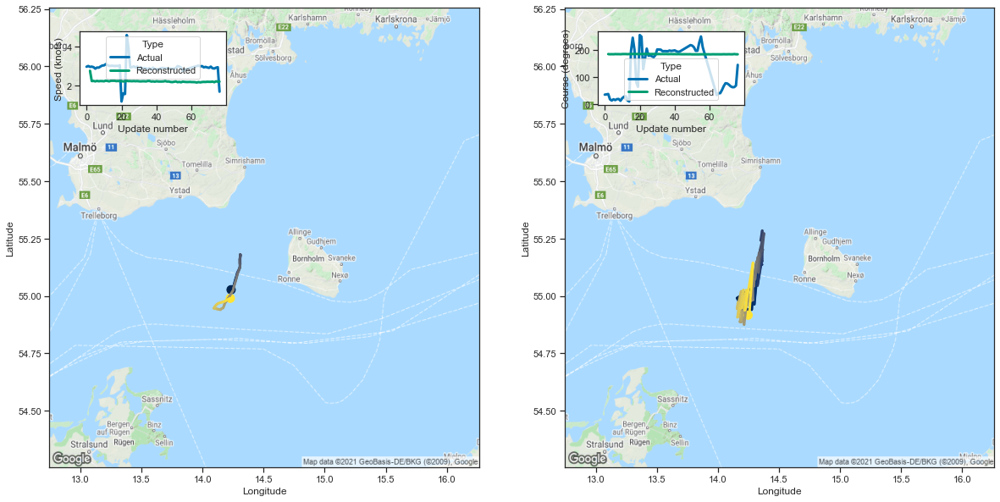

[2.7600533962249756, 2.2291531562805176, 2.237802028656006, 2.2146520614624023]


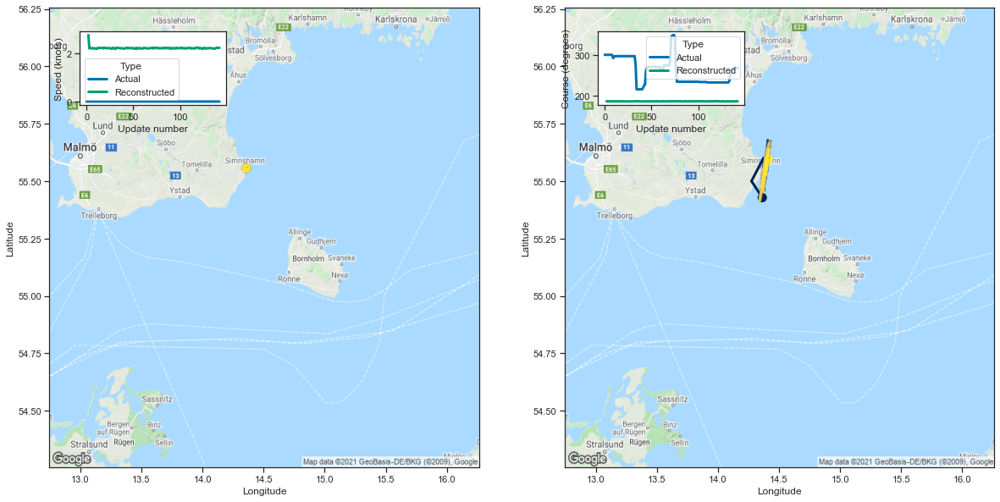

[2.7503700256347656, 2.1985530853271484, 2.2171237468719482, 2.204437255859375]


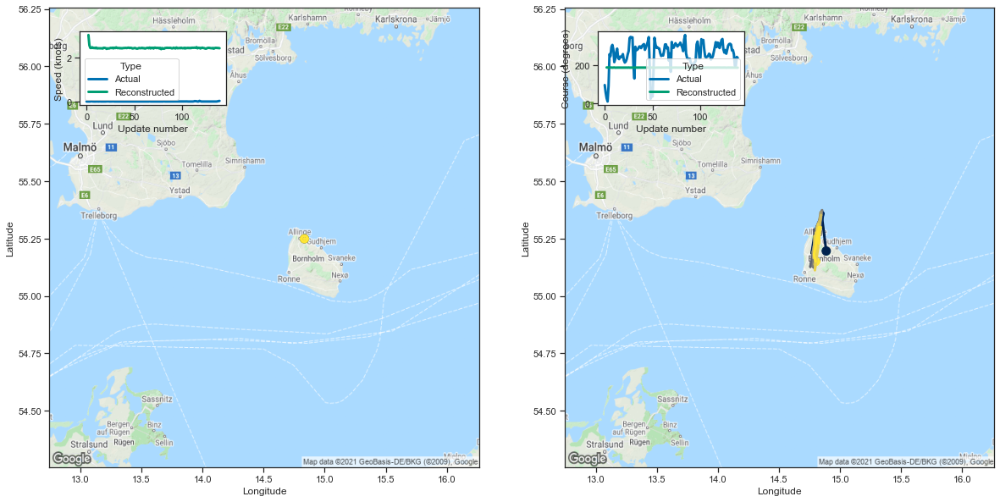

[3.016113519668579, 2.5496368408203125, 2.4306640625, 2.4265308380126953]


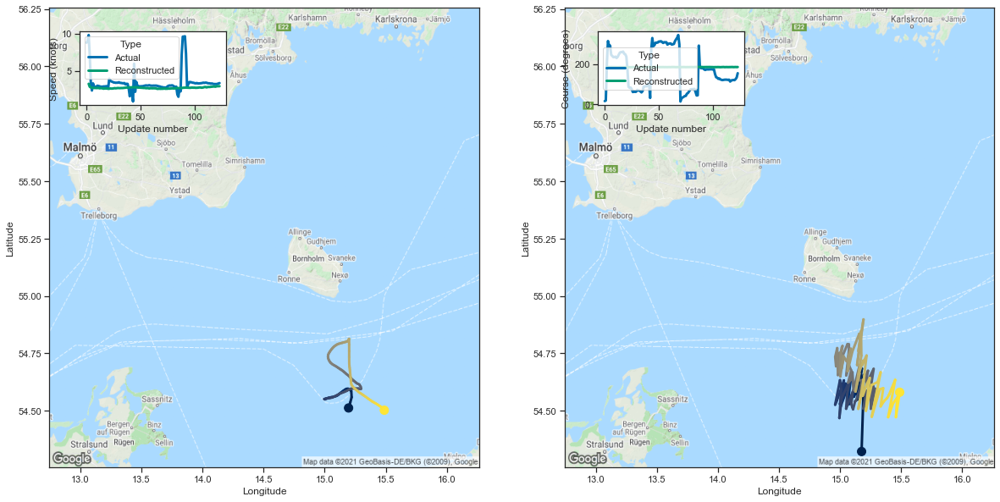

[3.248605728149414, 2.841377019882202, 2.769740104675293, 2.7143144607543945]


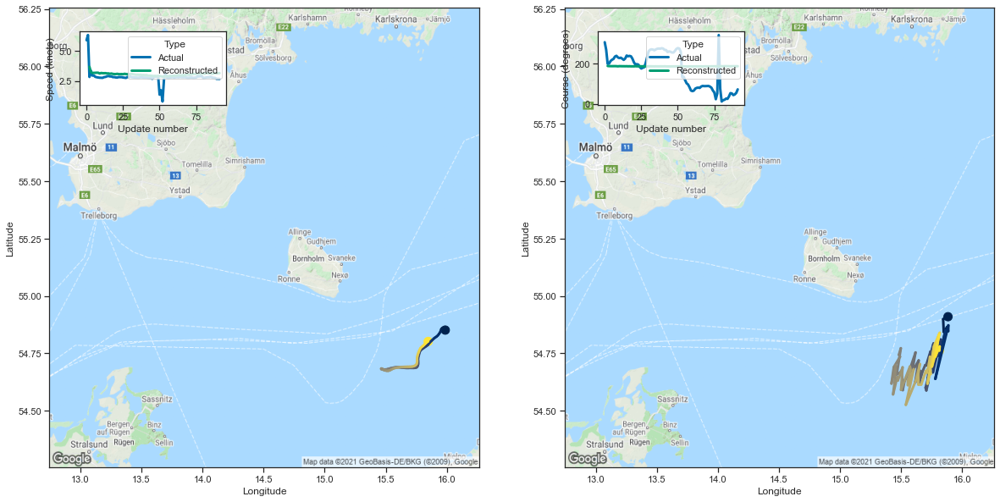

[3.6811017990112305, 3.246488332748413, 3.1645140647888184, 3.1760382652282715]


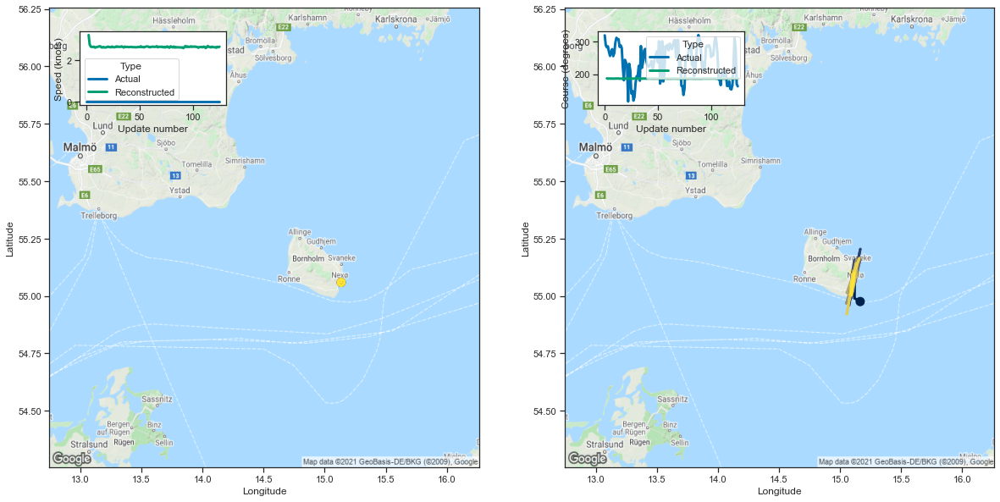

[3.198979616165161, 2.7342207431793213, 2.639526128768921, 2.626509189605713]


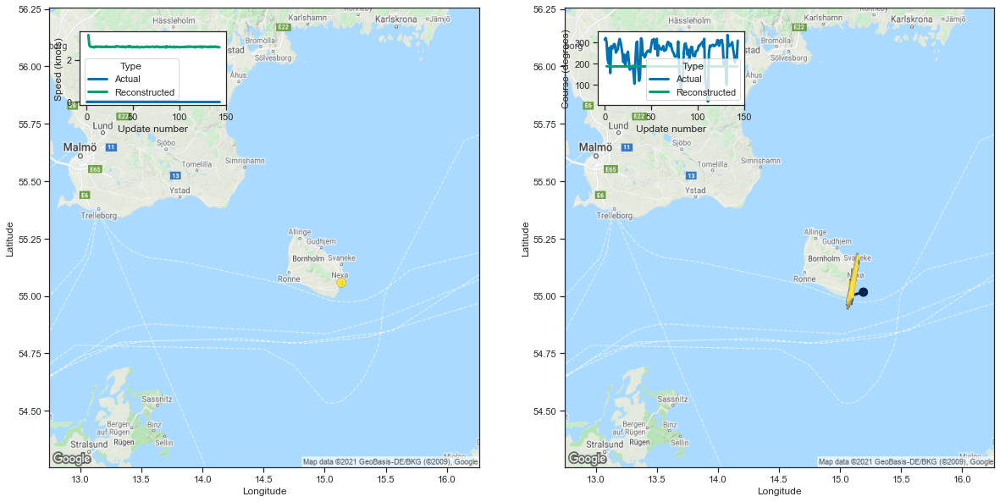

[3.188603401184082, 2.701148748397827, 2.630579710006714, 2.630155086517334]


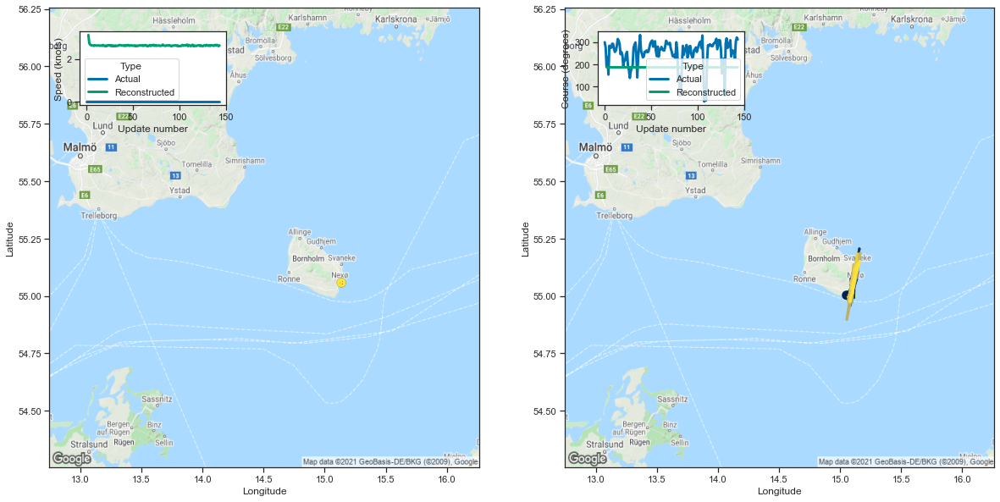

[3.116739273071289, 2.729541778564453, 2.661189079284668, 2.6365740299224854]


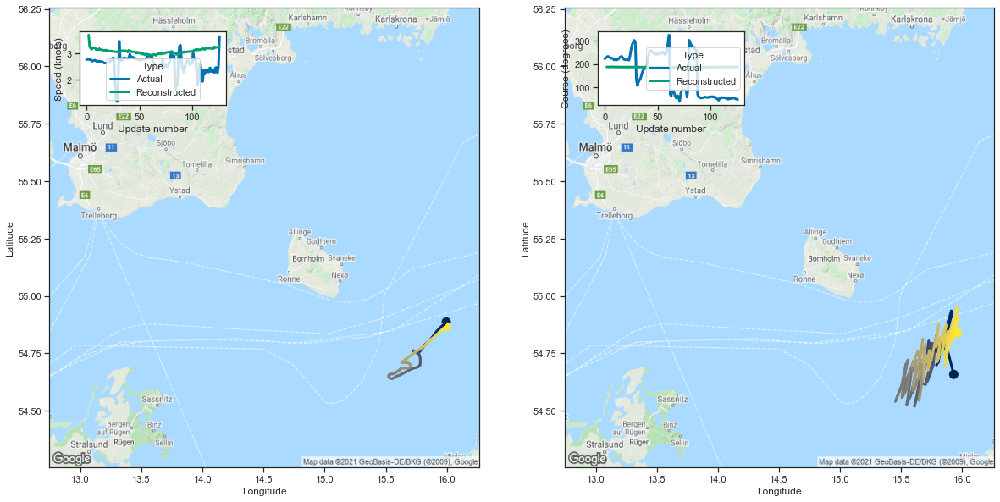

[3.6987714767456055, 3.2517478466033936, 3.188755512237549, 3.1588900089263916]


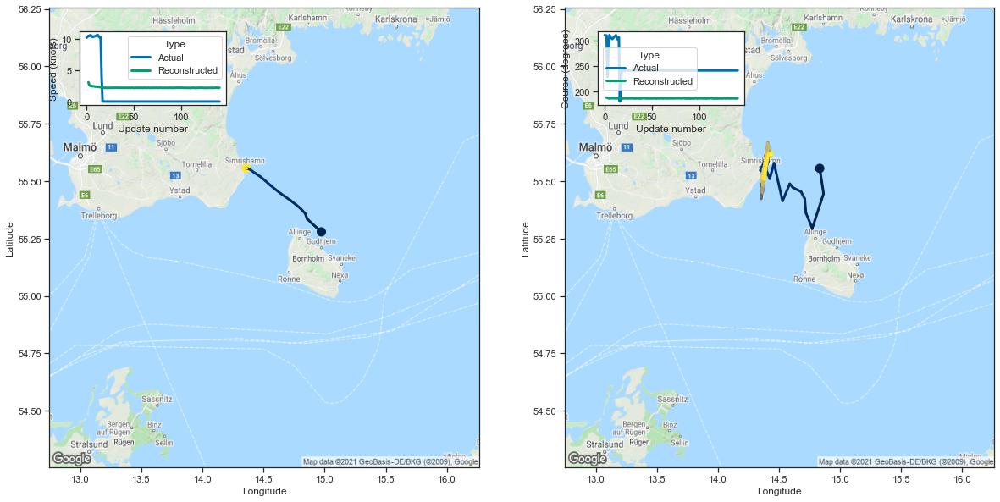

[3.096074342727661, 2.632068157196045, 2.5248961448669434, 2.5093905925750732]


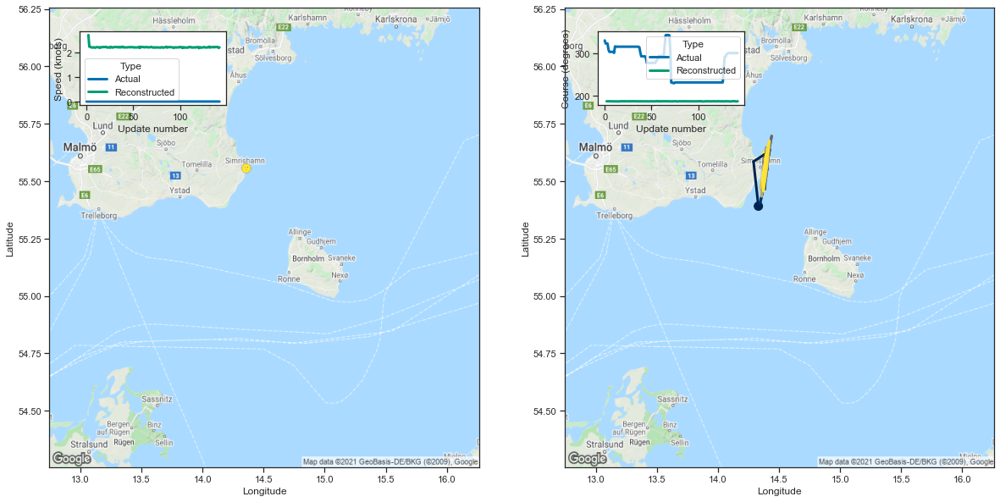

[2.7057621479034424, 2.2292449474334717, 2.228374719619751, 2.205031156539917]


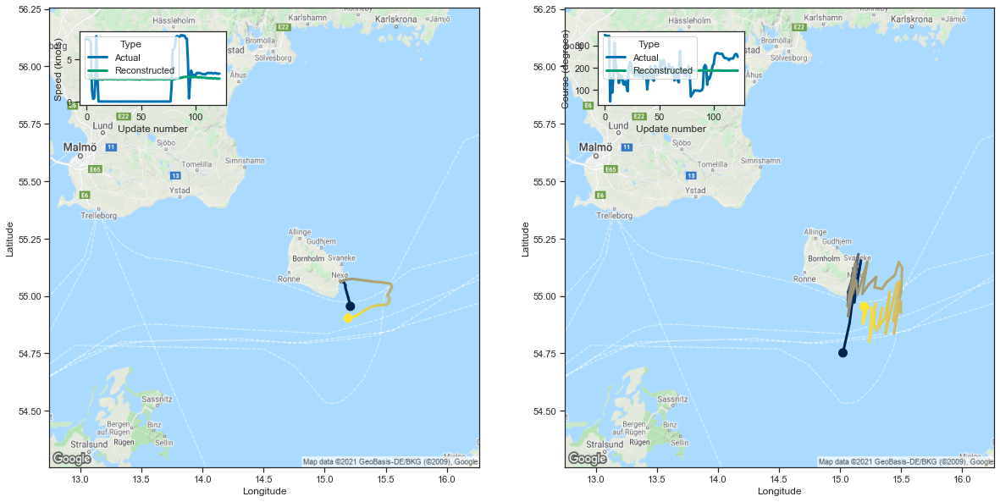

[3.1340224742889404, 2.7371935844421387, 2.6769580841064453, 2.6887412071228027]


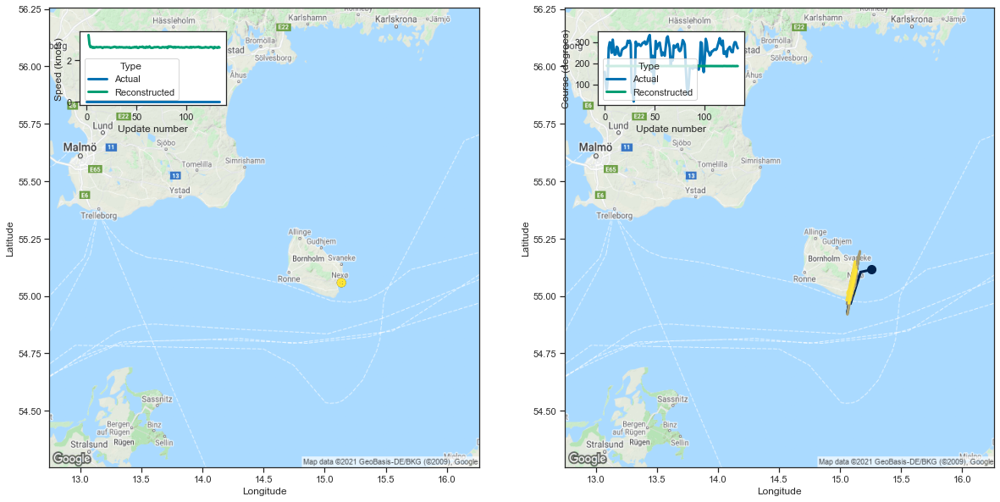

[3.214271306991577, 2.761863946914673, 2.6291537284851074, 2.6518516540527344]


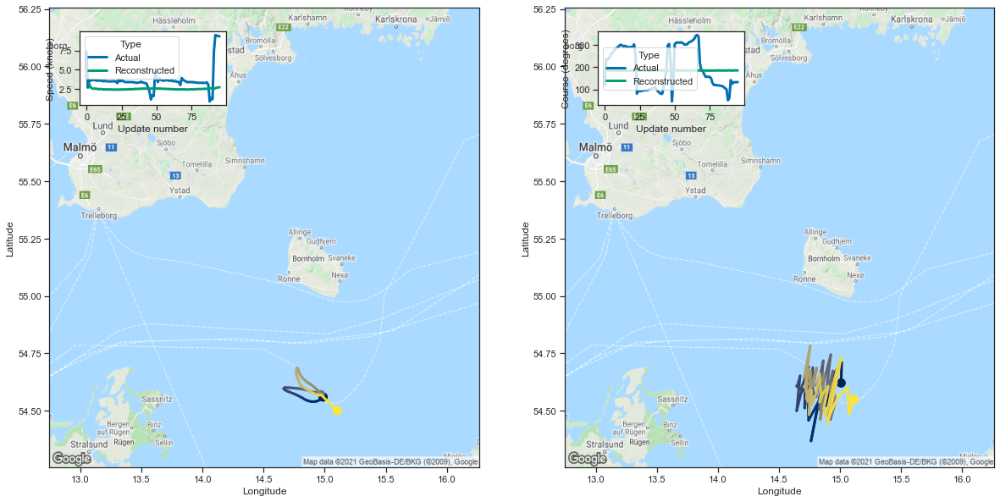

[3.1317310333251953, 2.698620080947876, 2.583249807357788, 2.5319766998291016]


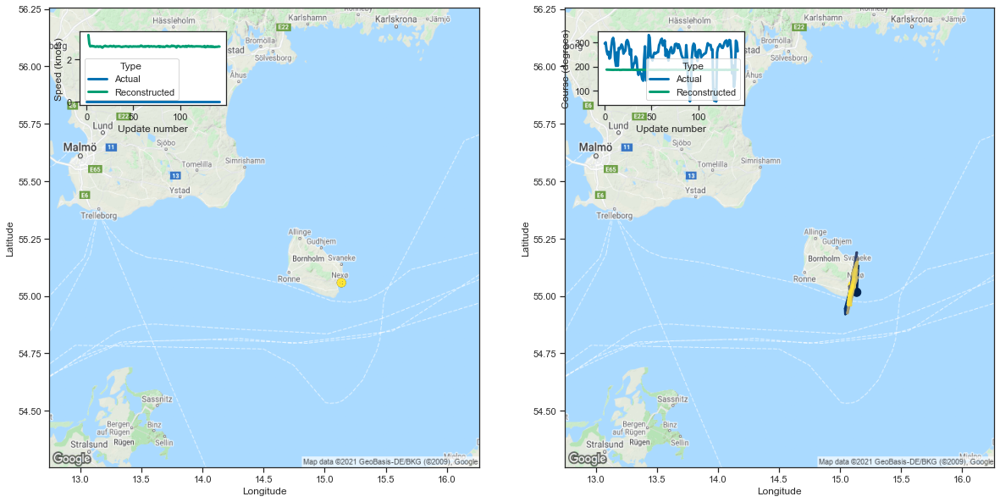

[3.1657543182373047, 2.751854419708252, 2.624448299407959, 2.631021738052368]


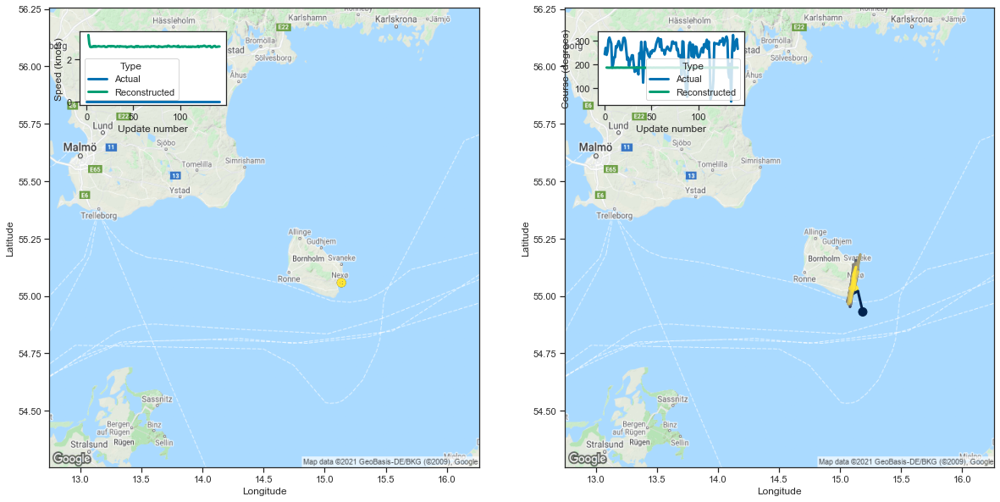

[3.1735565662384033, 2.7527694702148438, 2.611360549926758, 2.59670090675354]


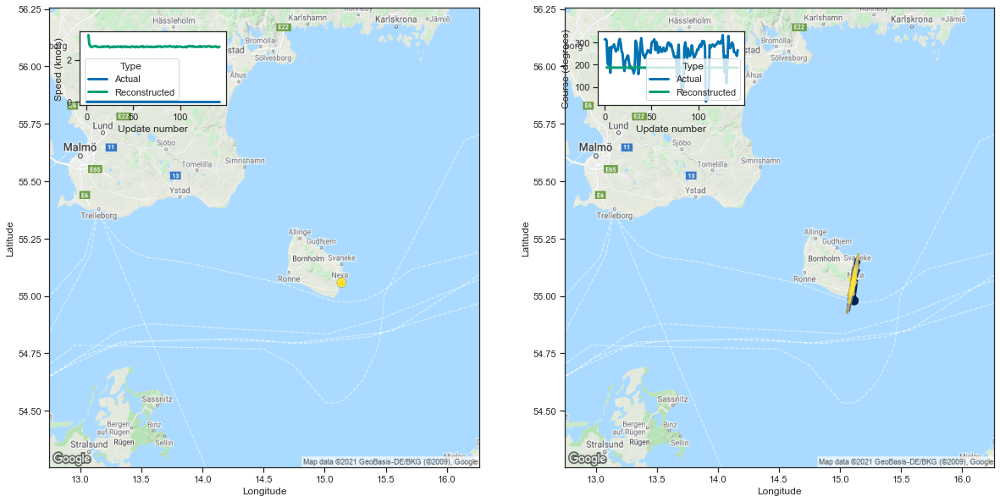

[3.1810567378997803, 2.739398717880249, 2.660505771636963, 2.603182792663574]


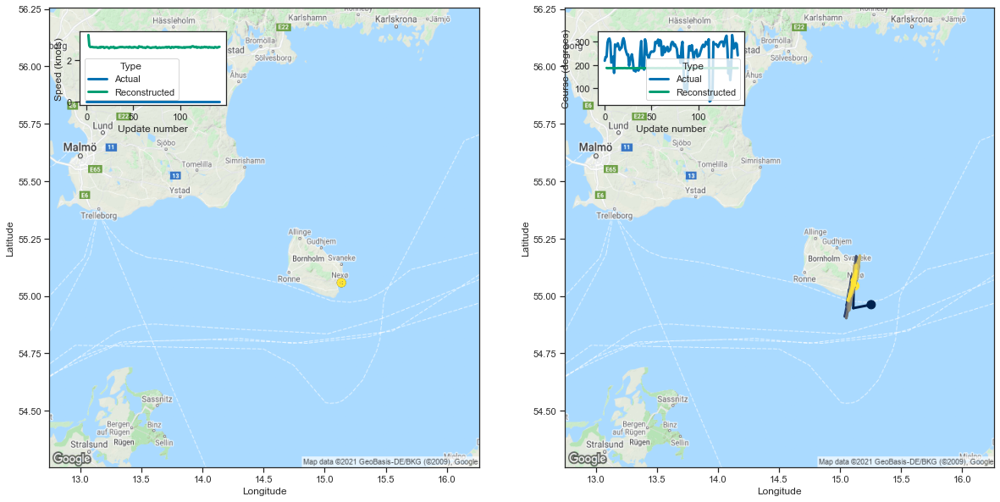

[3.216475009918213, 2.703450918197632, 2.638317584991455, 2.6390531063079834]


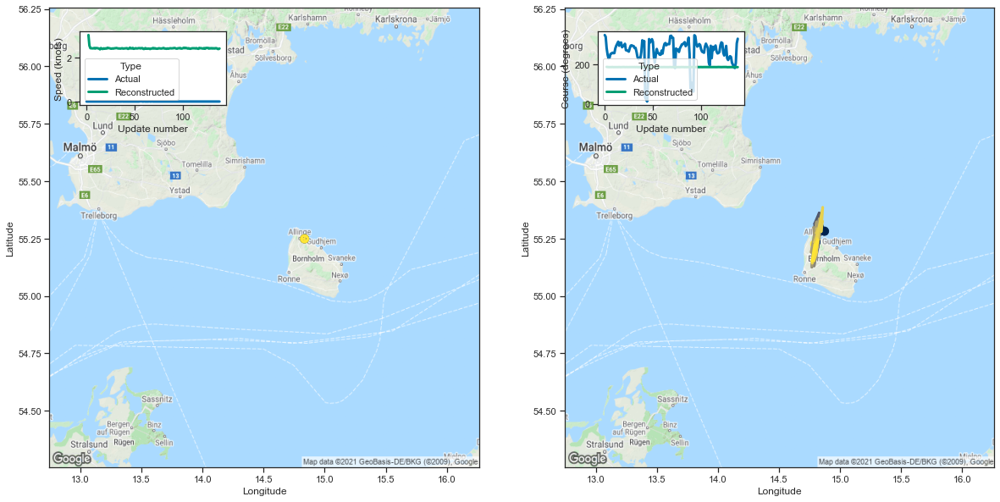

[3.034888505935669, 2.5535521507263184, 2.435285806655884, 2.42895245552063]


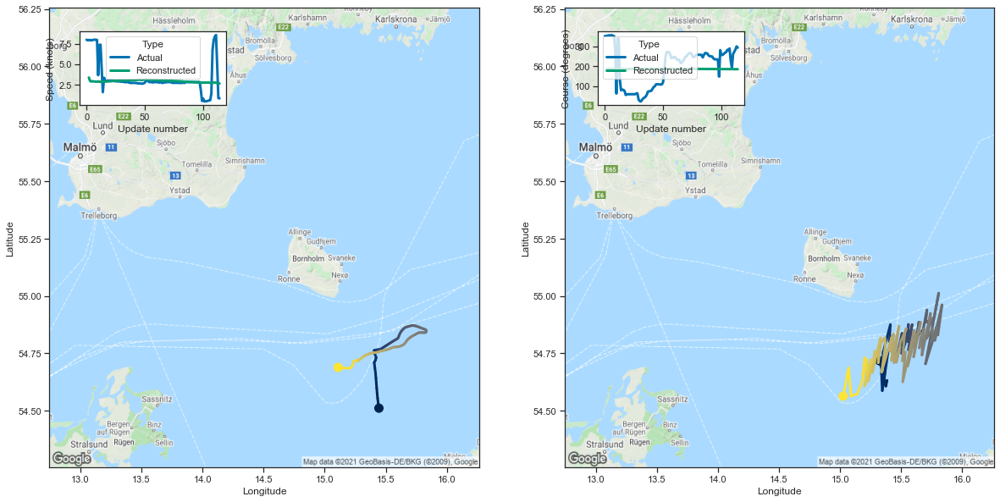

[3.357302665710449, 2.940267324447632, 2.869607448577881, 2.8997836112976074]


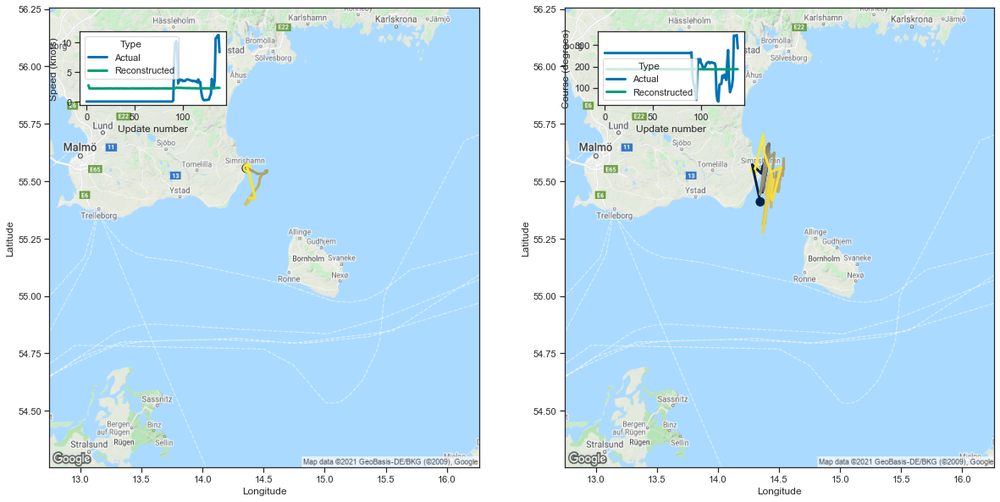

[2.754551649093628, 2.2200582027435303, 2.2036755084991455, 2.211270332336426]


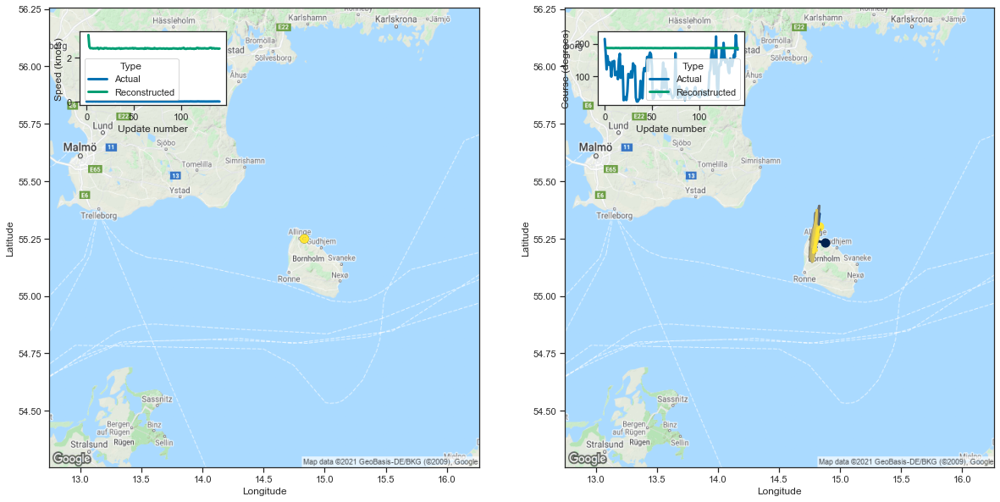

[3.0336697101593018, 2.508418321609497, 2.432234525680542, 2.4349052906036377]


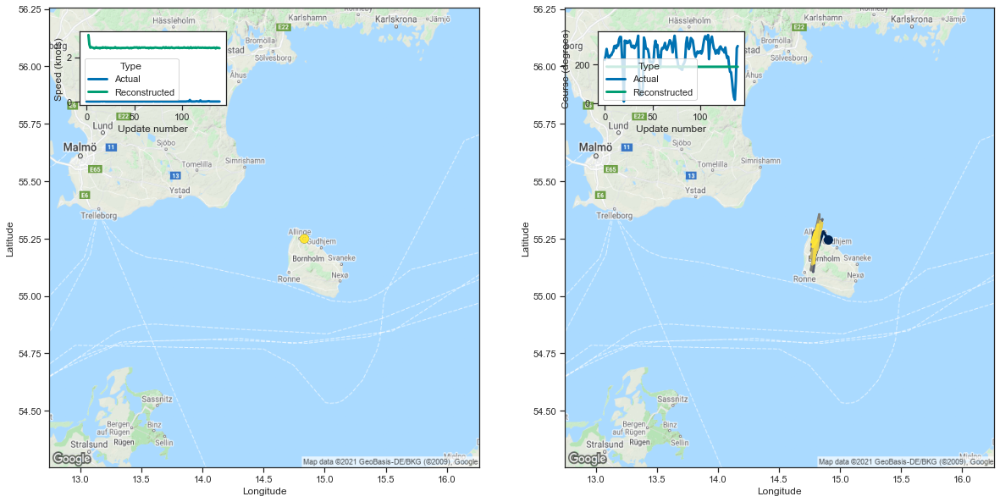

[3.001429557800293, 2.571429491043091, 2.4300625324249268, 2.4465487003326416]


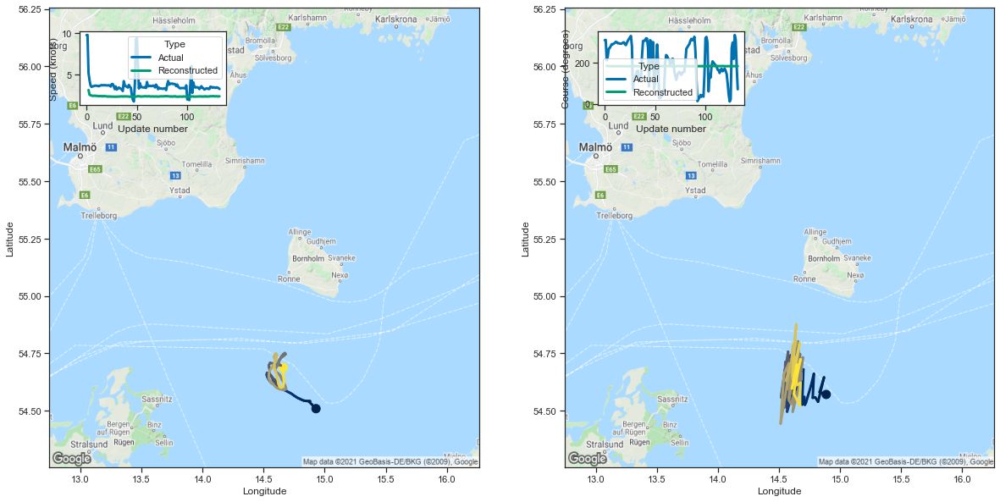

[3.1752378940582275, 2.5984926223754883, 2.5473837852478027, 2.494446277618408]


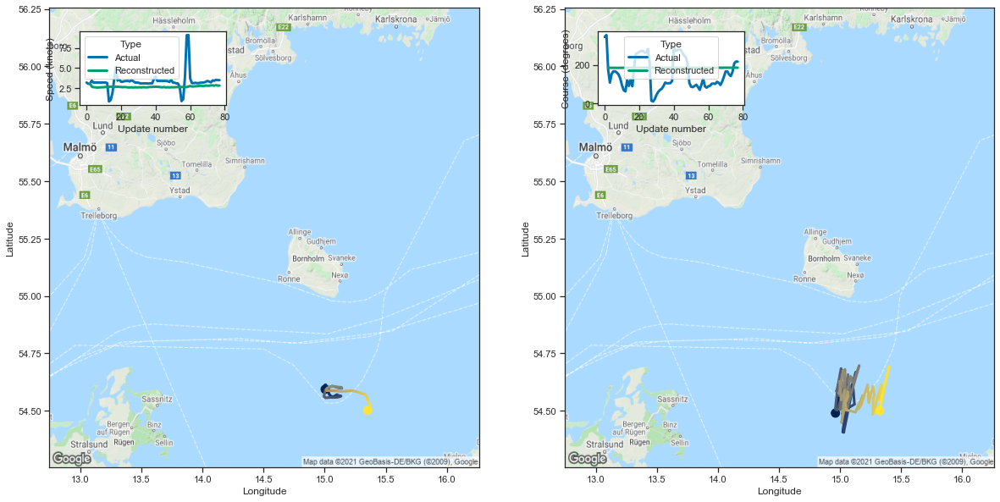

[3.097290515899658, 2.695800304412842, 2.6196393966674805, 2.6078860759735107]


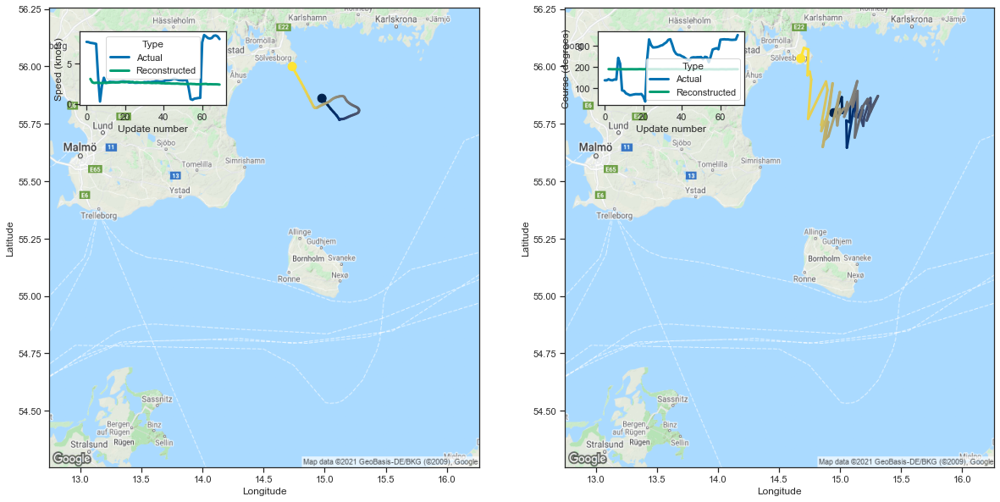

[3.0751254558563232, 2.6567370891571045, 2.5763070583343506, 2.6016876697540283]


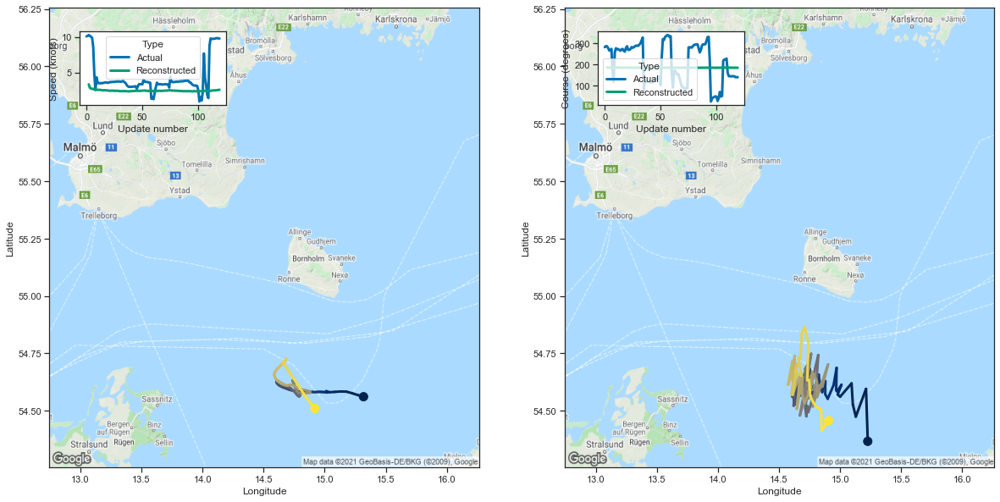

[3.35829758644104, 2.8675830364227295, 2.769148588180542, 2.714651346206665]


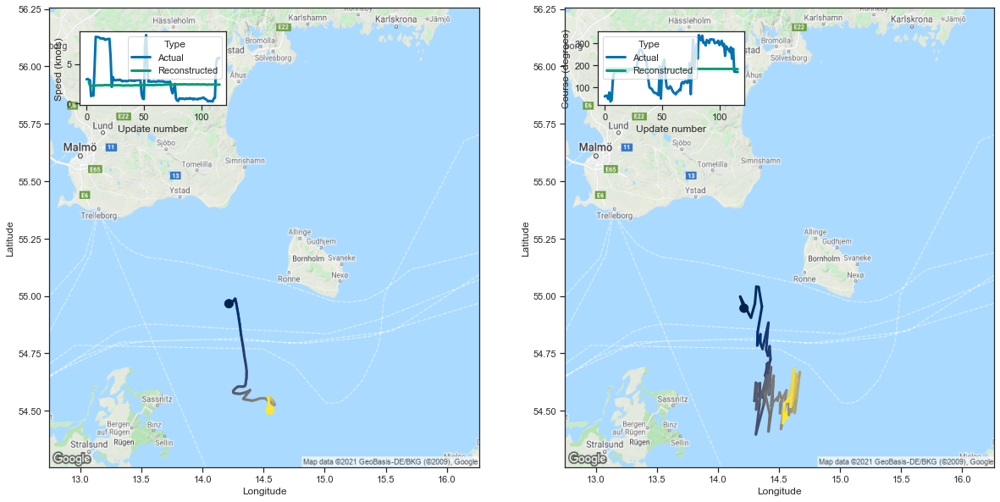

[2.718733787536621, 2.2578773498535156, 2.230445384979248, 2.2317404747009277]


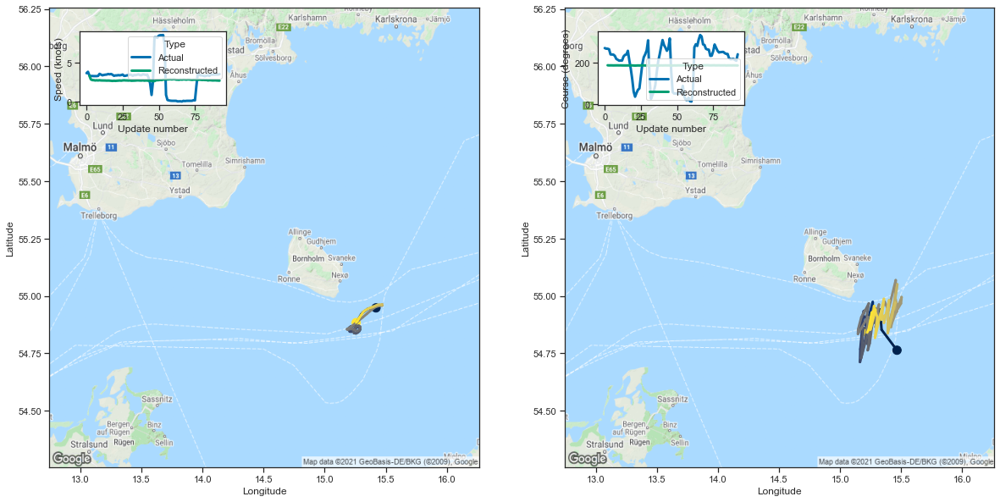

[3.3457839488983154, 2.873049736022949, 2.7853121757507324, 2.7750375270843506]


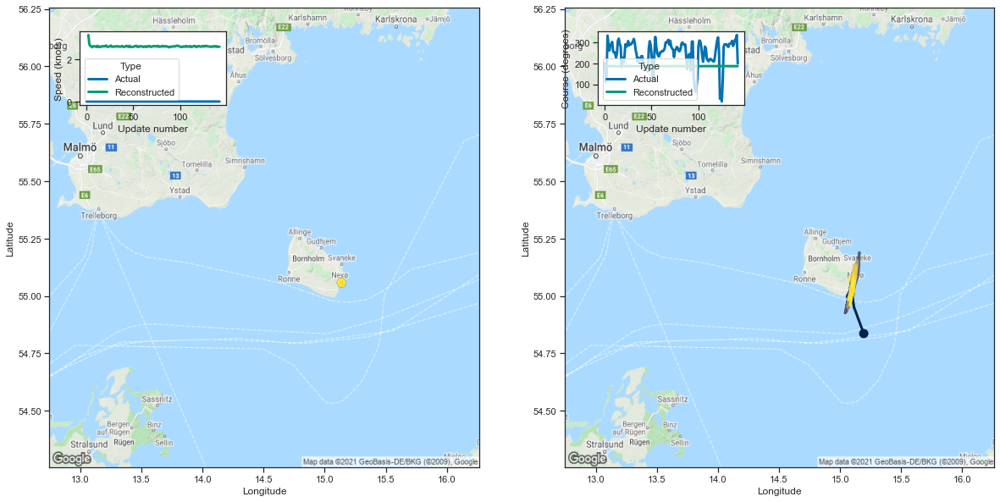

[3.166245460510254, 2.736743211746216, 2.6439549922943115, 2.6292169094085693]


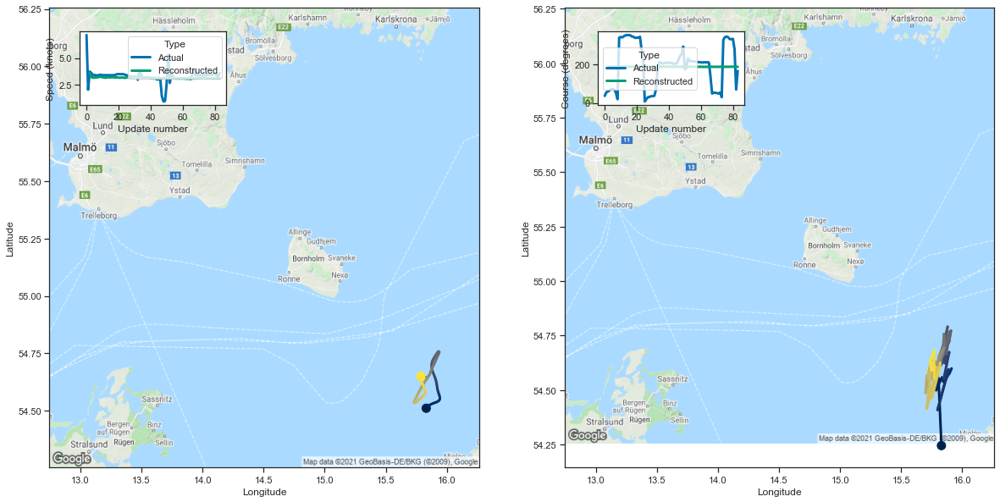

[3.6380903720855713, 3.239840507507324, 3.1569504737854004, 3.1823601722717285]


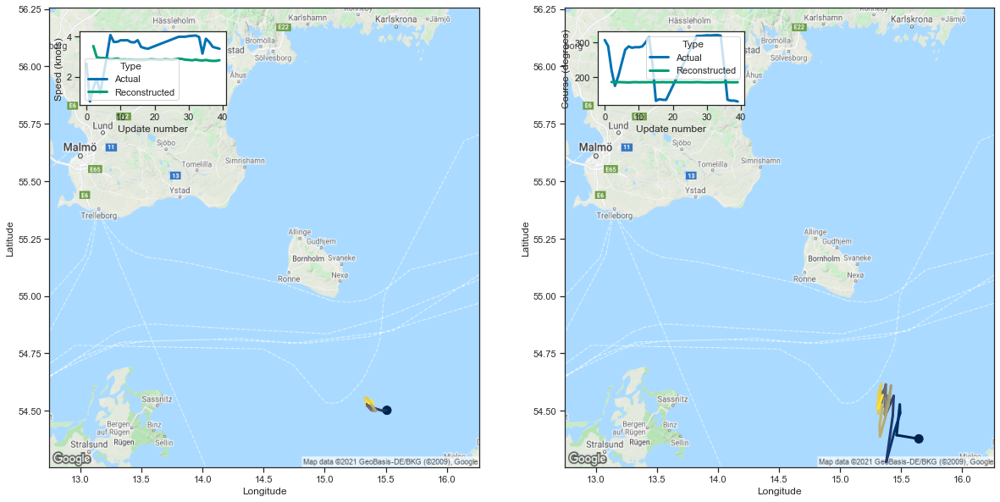

[3.5375750064849854, 2.9749722480773926, 2.940035820007324, 2.93715500831604]


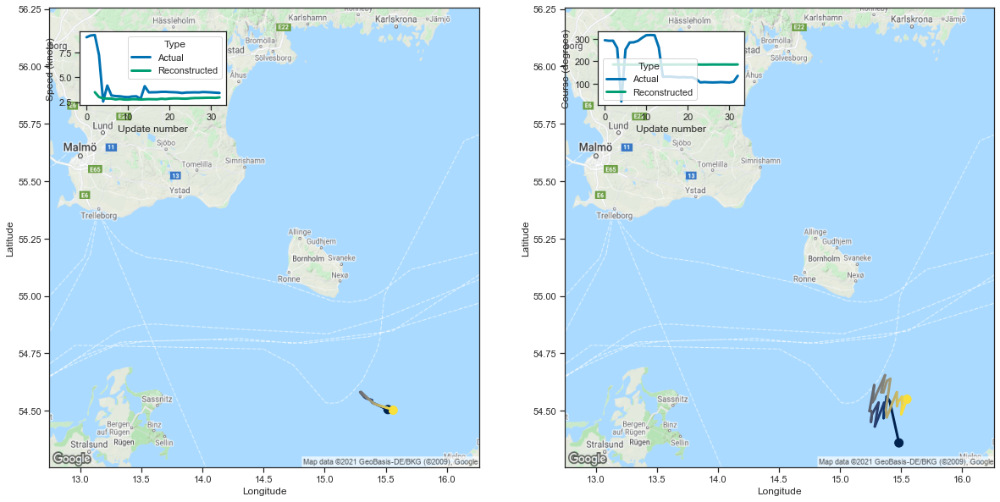

[3.4955925941467285, 3.0121562480926514, 2.8780128955841064, 2.856793165206909]


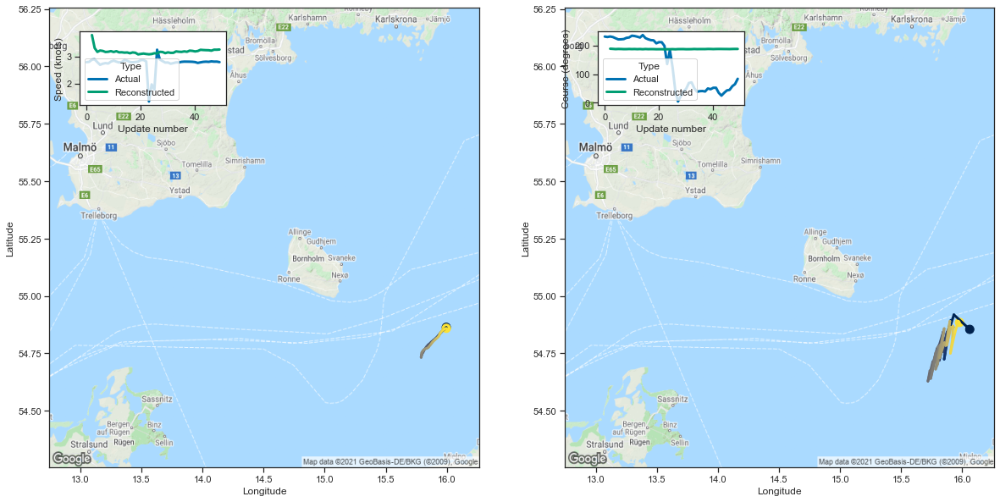

[3.781585693359375, 3.305344581604004, 3.1622977256774902, 3.2137863636016846]


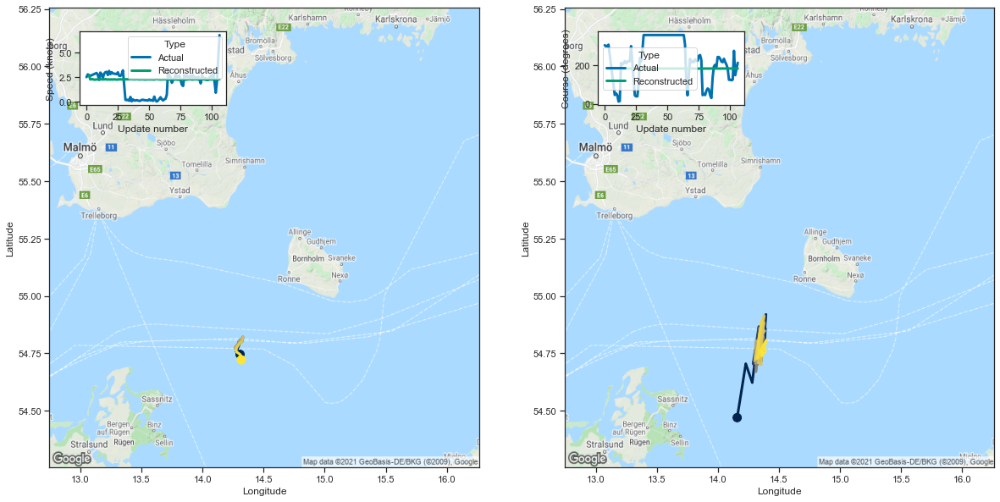

[2.663069486618042, 2.261455535888672, 2.2780871391296387, 2.277355909347534]


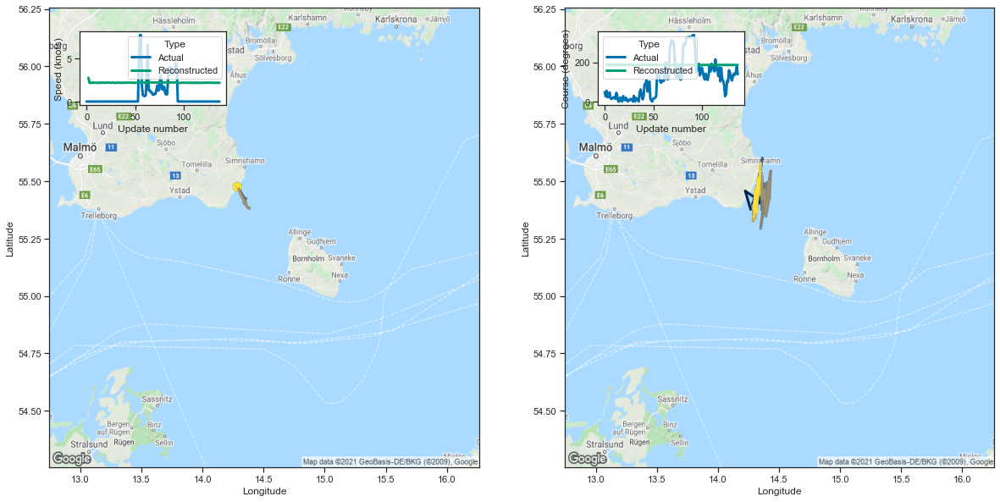

[2.7625999450683594, 2.203115701675415, 2.173090696334839, 2.1782984733581543]


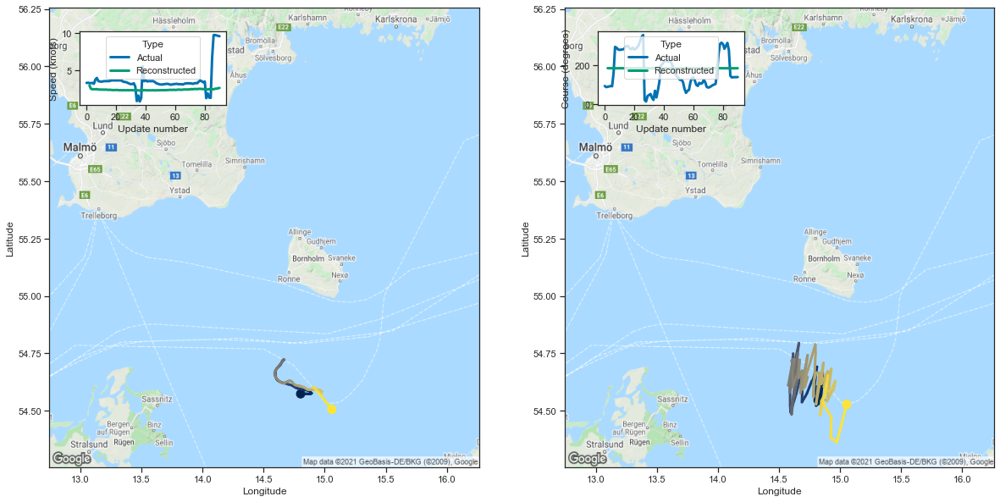

[3.0331194400787354, 2.5842511653900146, 2.52531099319458, 2.5300111770629883]


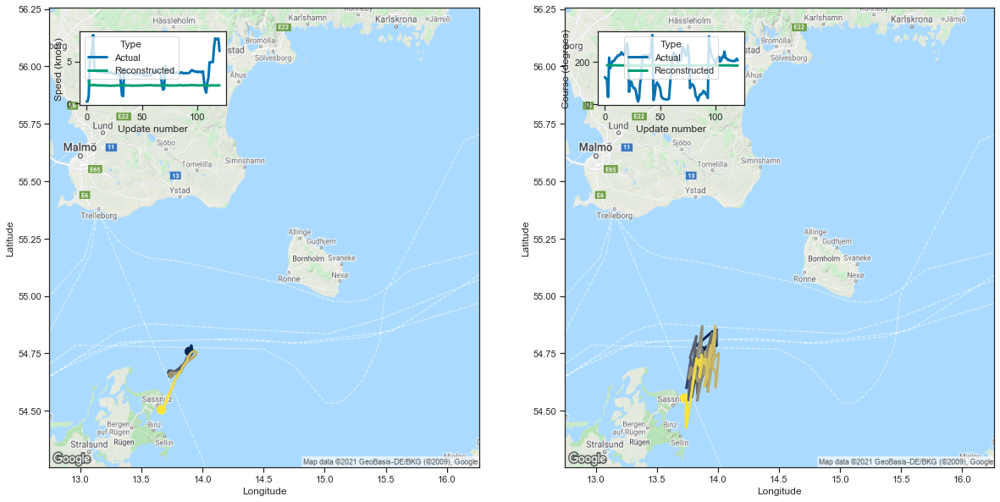

[2.658616065979004, 2.144979238510132, 2.138685941696167, 2.1545629501342773]


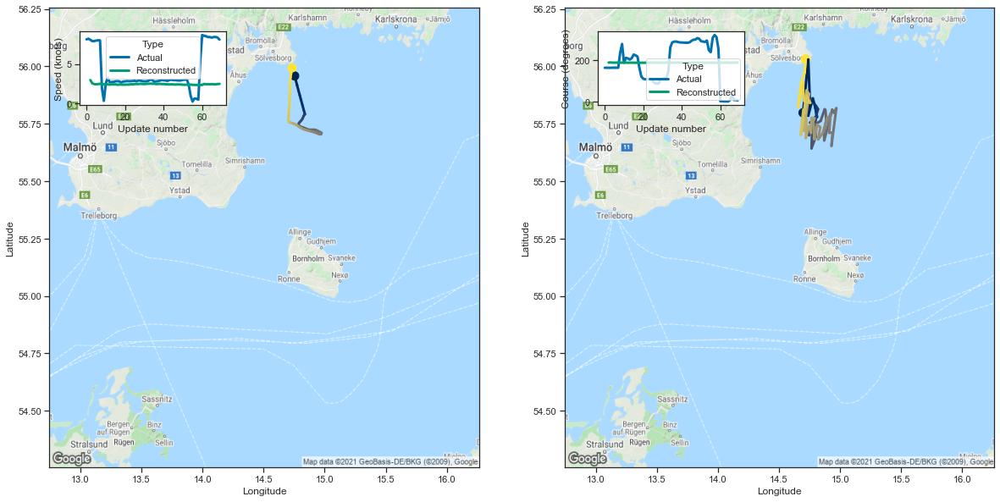

[2.9521677494049072, 2.529392719268799, 2.4473602771759033, 2.4087018966674805]


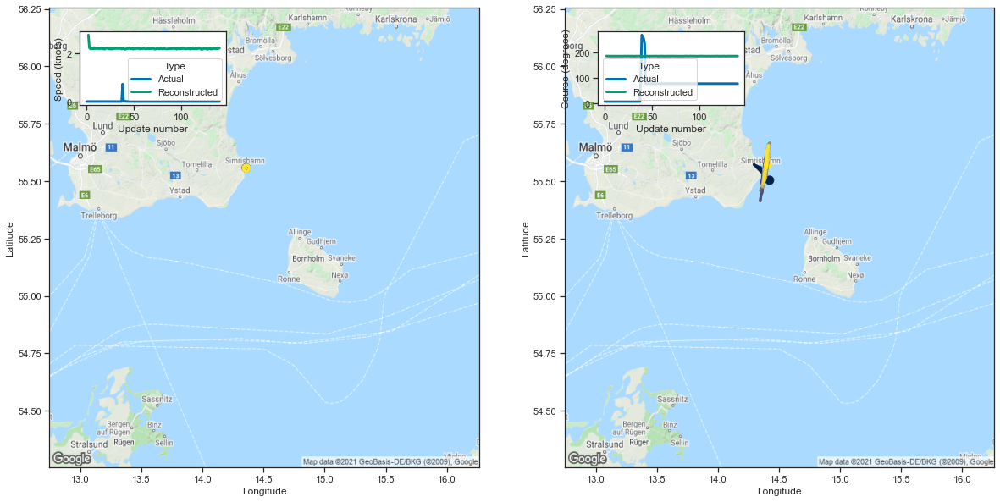

[2.781951665878296, 2.250779867172241, 2.2050628662109375, 2.2021498680114746]


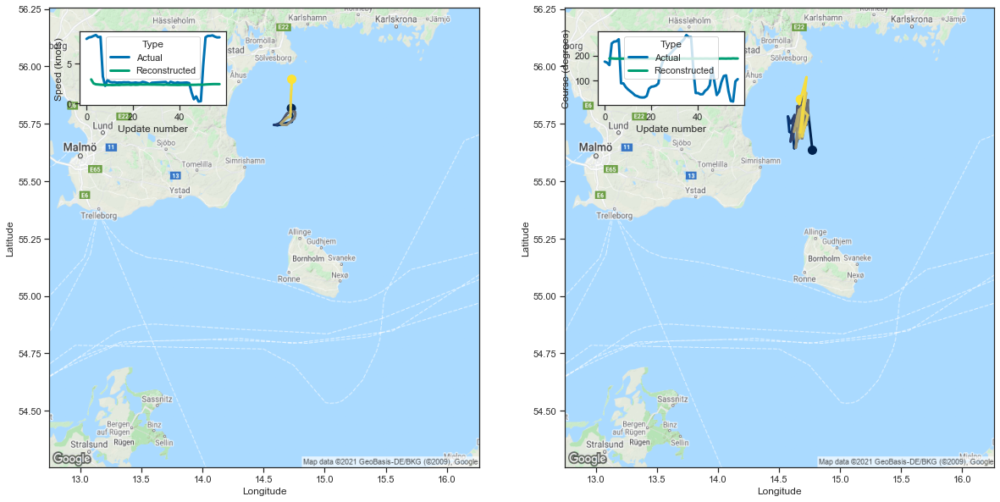

[3.011463165283203, 2.508450746536255, 2.389979124069214, 2.367201328277588]


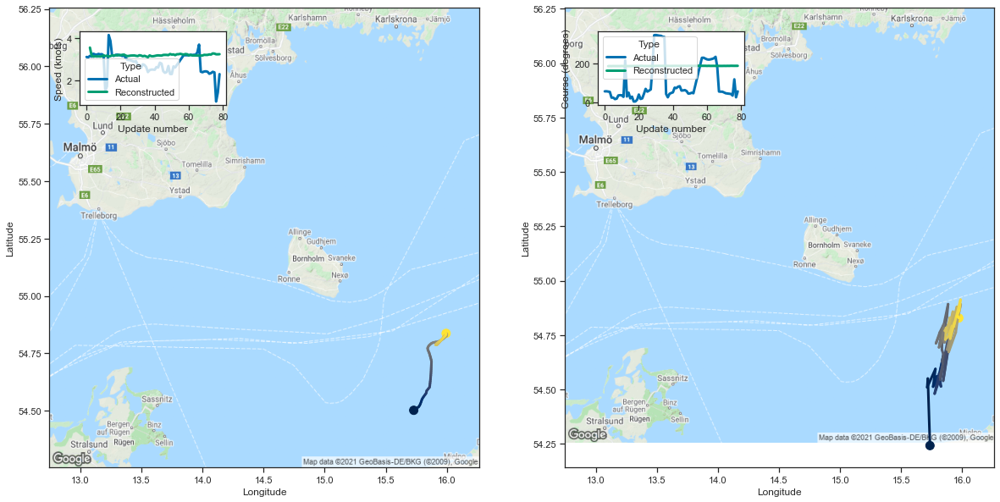

[3.5572268962860107, 3.1768760681152344, 3.127333879470825, 3.1466190814971924]


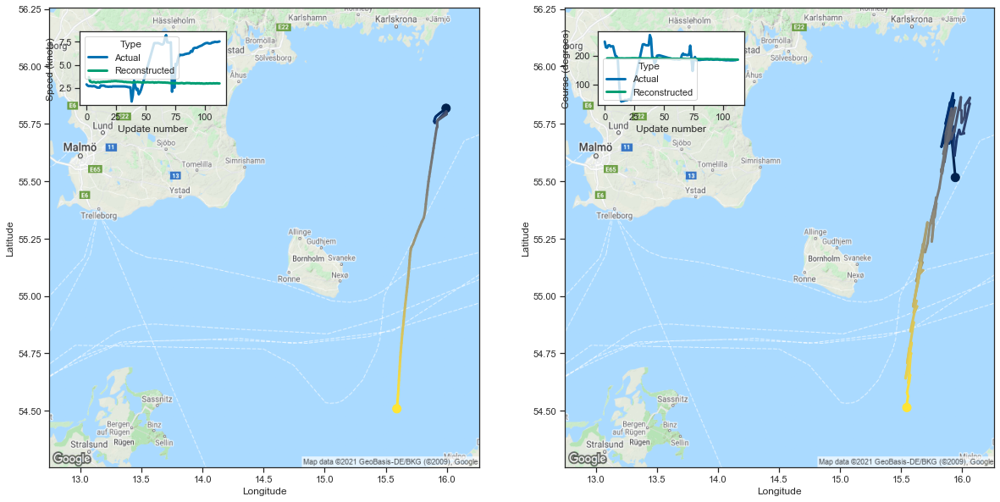

[3.6583101749420166, 3.197300910949707, 3.134121894836426, 3.1024186611175537]


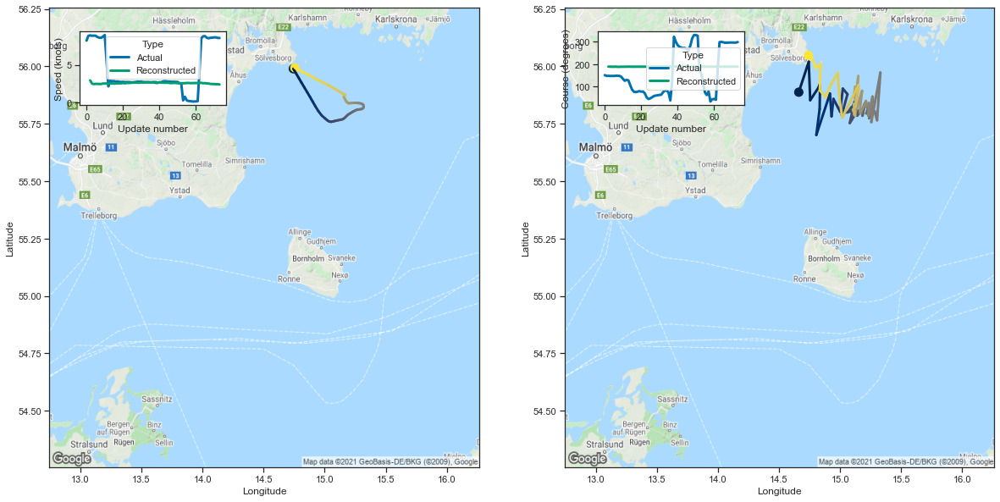

[2.947859525680542, 2.5336828231811523, 2.4677419662475586, 2.497007131576538]


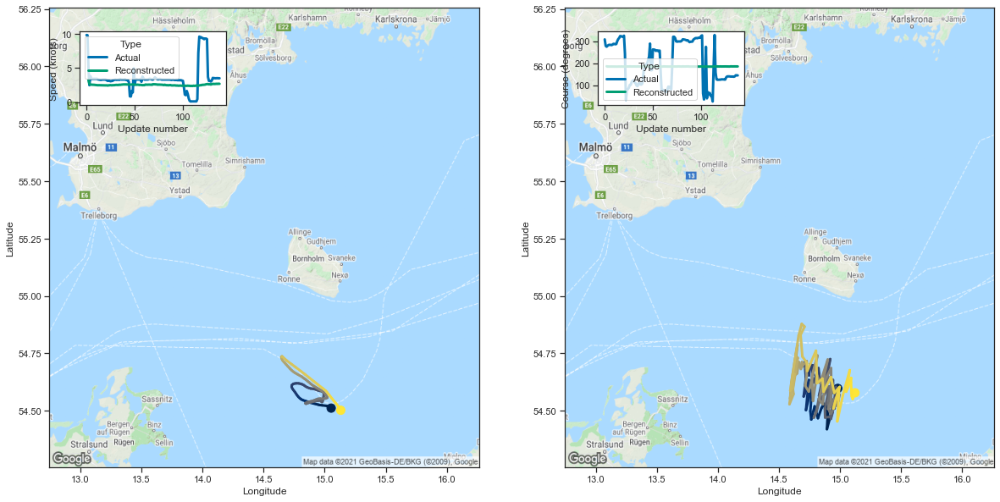

[3.210319995880127, 2.655463218688965, 2.5587377548217773, 2.552828788757324]


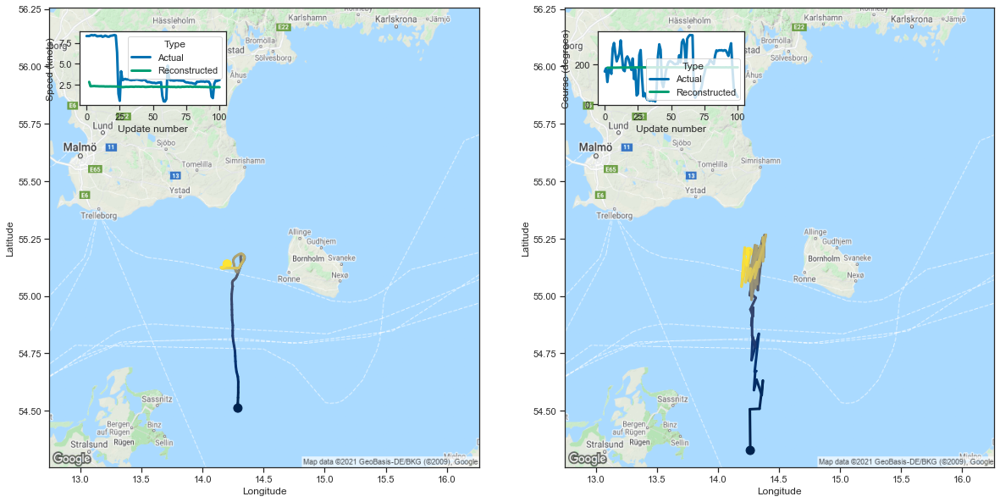

[2.8164172172546387, 2.2935495376586914, 2.3025896549224854, 2.315945863723755]


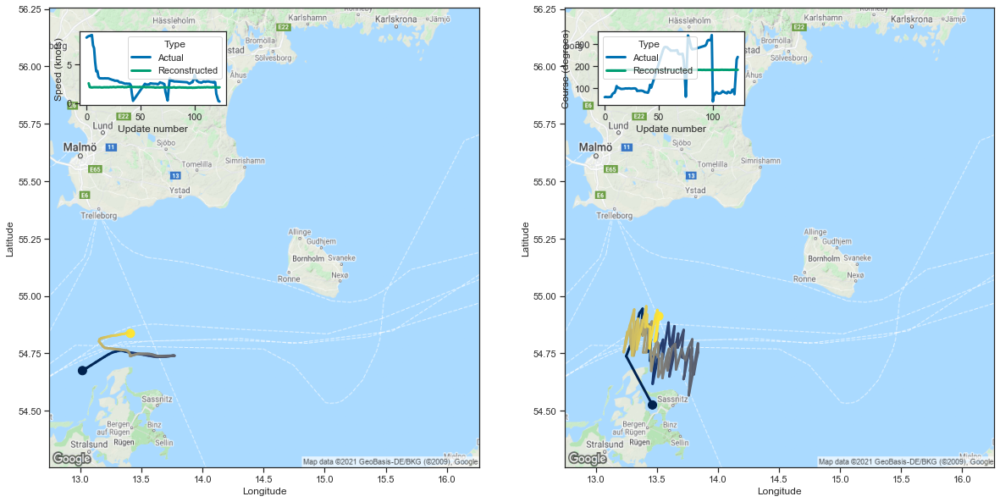

[2.570014476776123, 2.0756382942199707, 2.0352623462677, 2.0208075046539307]


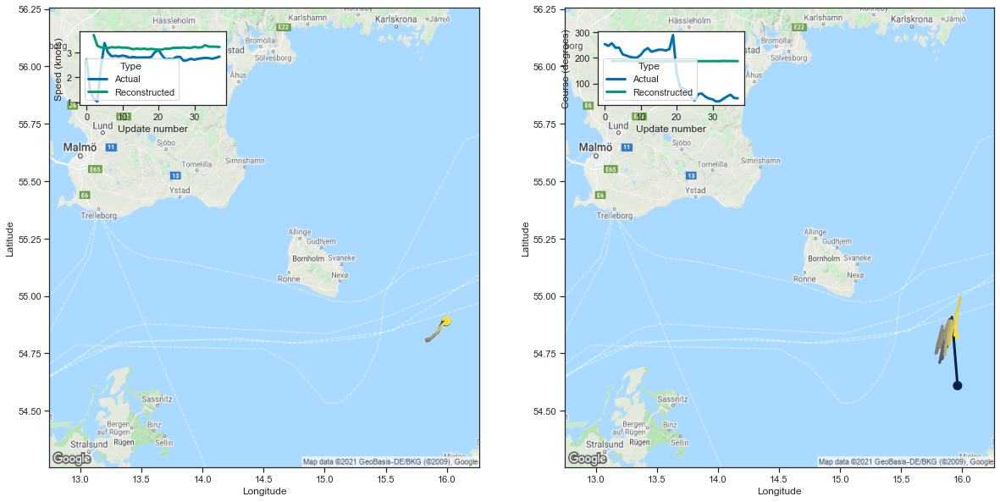

[3.705376386642456, 3.277205467224121, 3.207160711288452, 3.194455862045288]


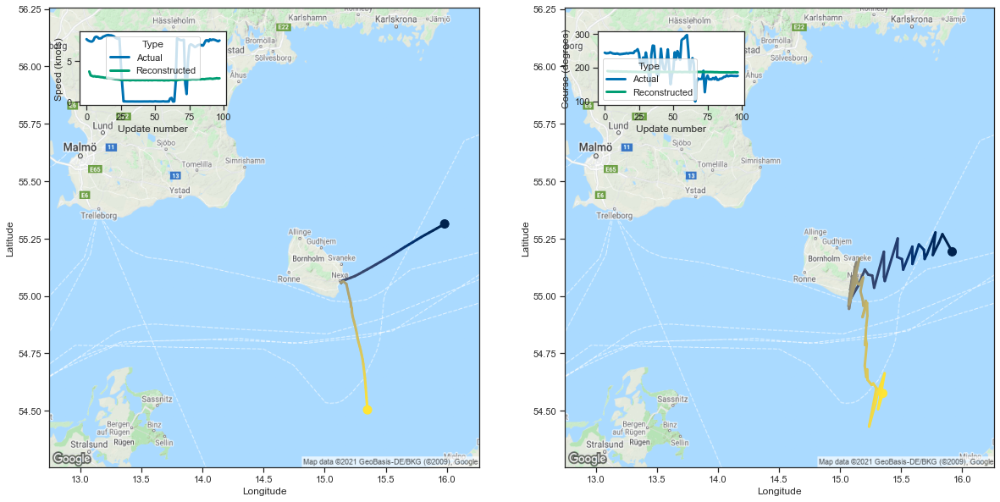

[3.6908886432647705, 3.220402479171753, 3.1418206691741943, 3.0850942134857178]


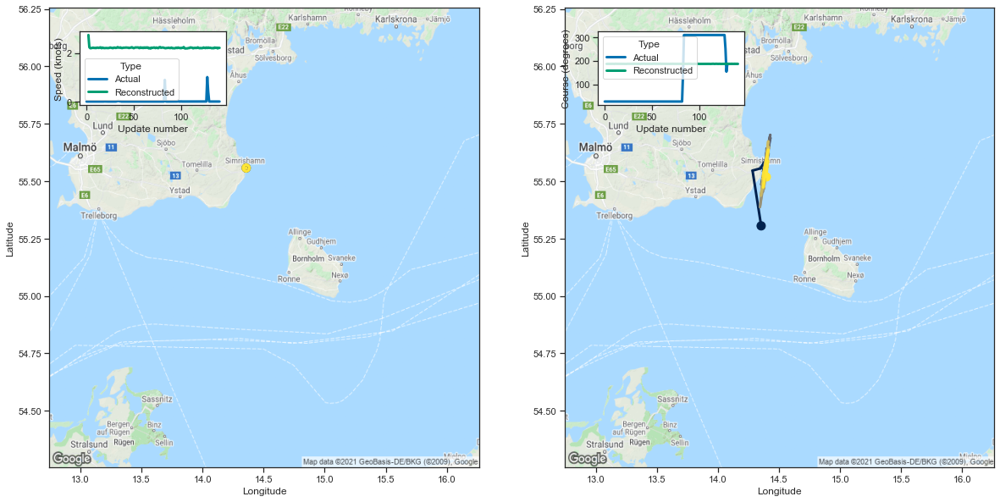

[2.740200996398926, 2.23661208152771, 2.197516918182373, 2.1994242668151855]


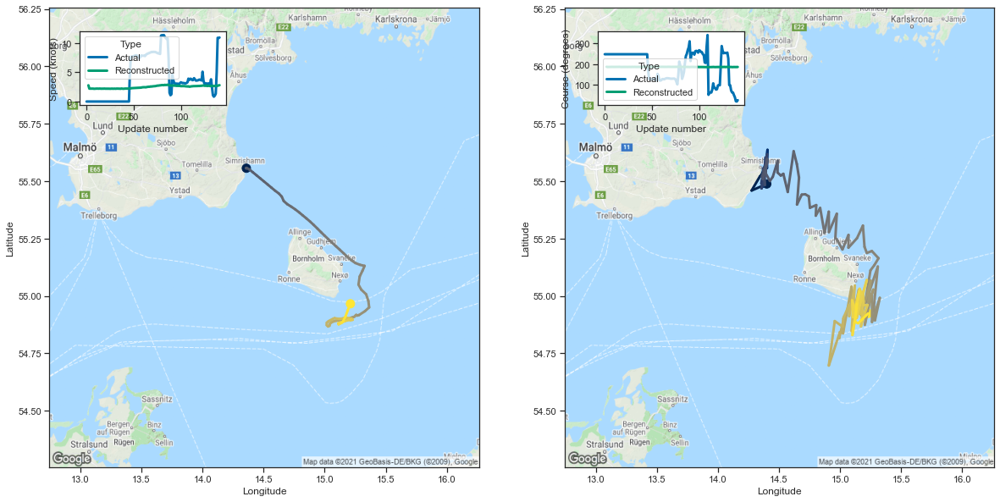

[2.778536081314087, 2.206836462020874, 2.210432291030884, 2.2077200412750244]


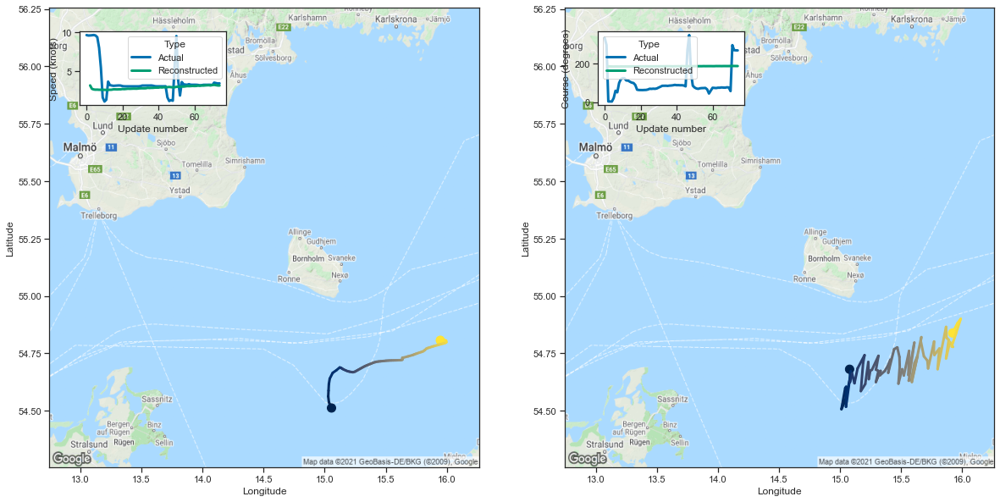

[3.215986967086792, 2.781825304031372, 2.69958758354187, 2.6726186275482178]


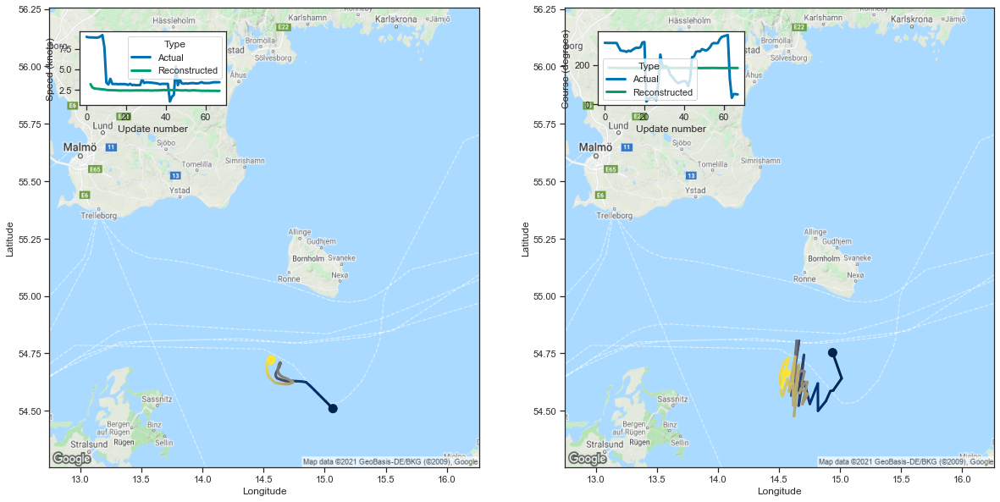

[3.169137716293335, 2.7556092739105225, 2.638343334197998, 2.6034159660339355]


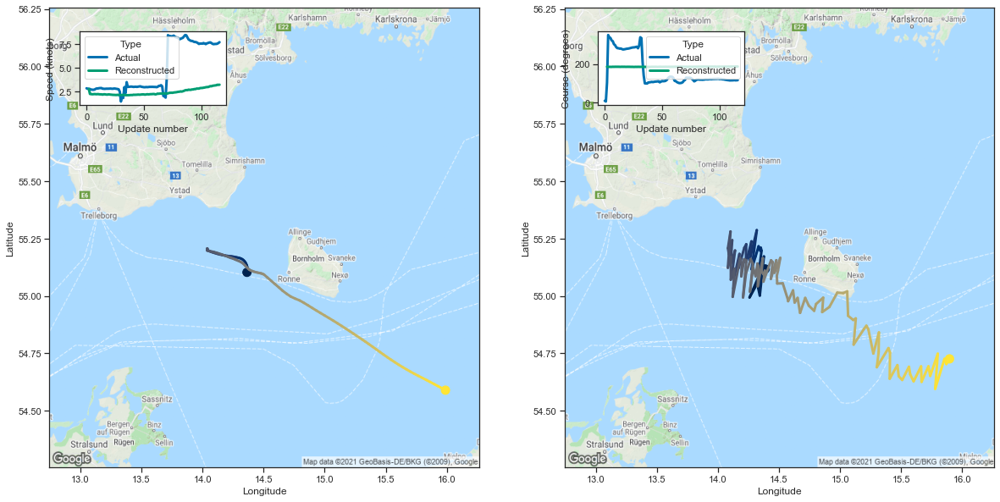

[2.7793593406677246, 2.2533812522888184, 2.239926338195801, 2.222275733947754]


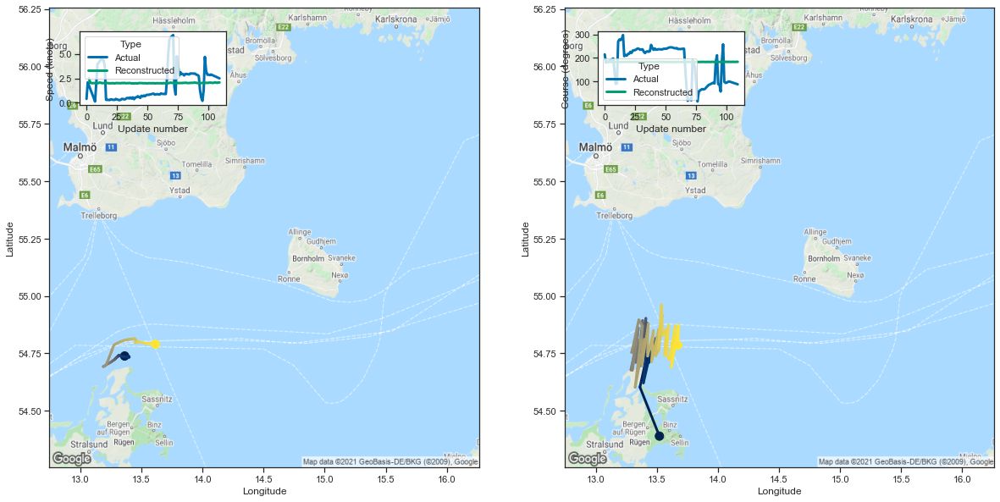

[2.5226099491119385, 2.0563976764678955, 2.0193426609039307, 2.007152795791626]


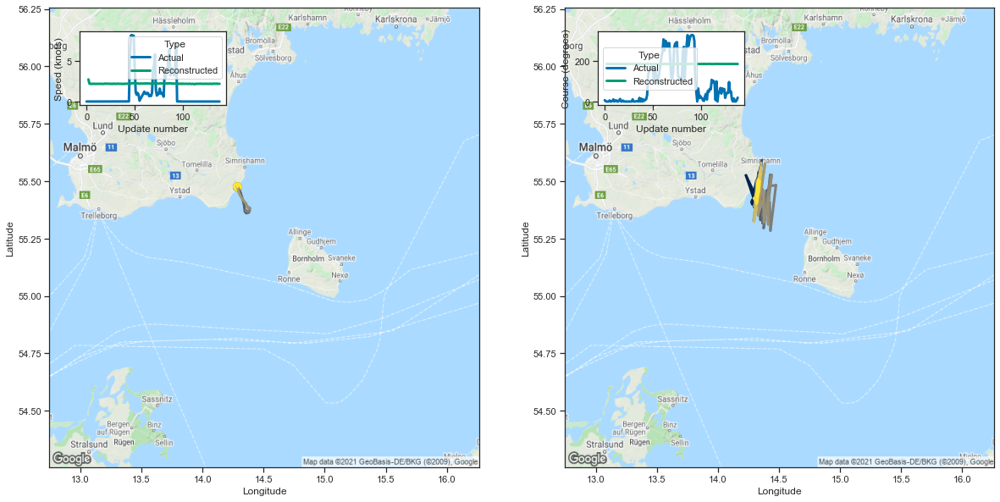

[2.737274646759033, 2.2199642658233643, 2.1834897994995117, 2.1917381286621094]


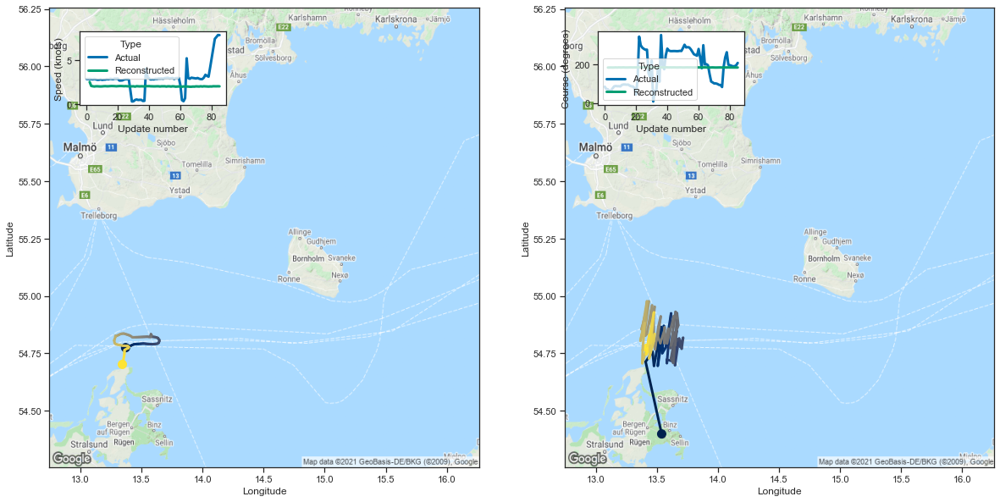

[2.5474252700805664, 2.0878424644470215, 2.0522282123565674, 2.0254921913146973]


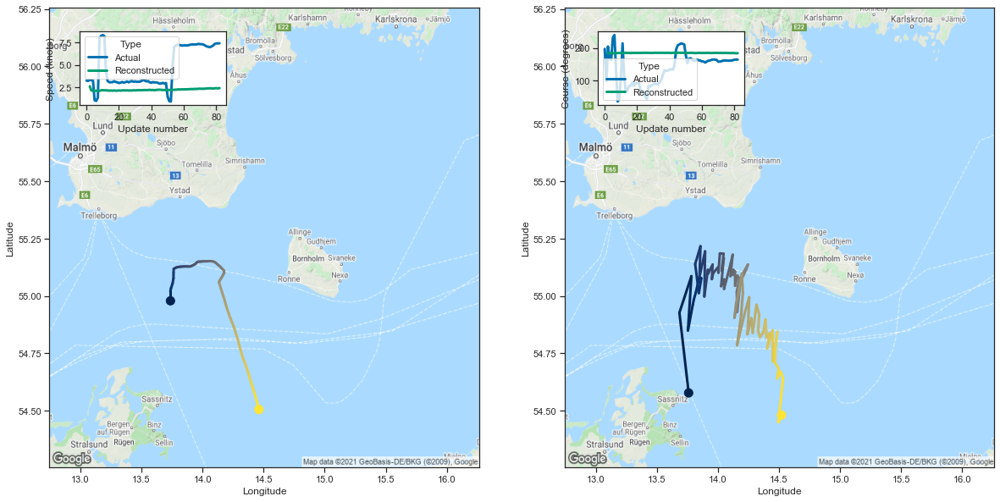

[2.583202600479126, 2.1104495525360107, 2.0803933143615723, 2.0891330242156982]


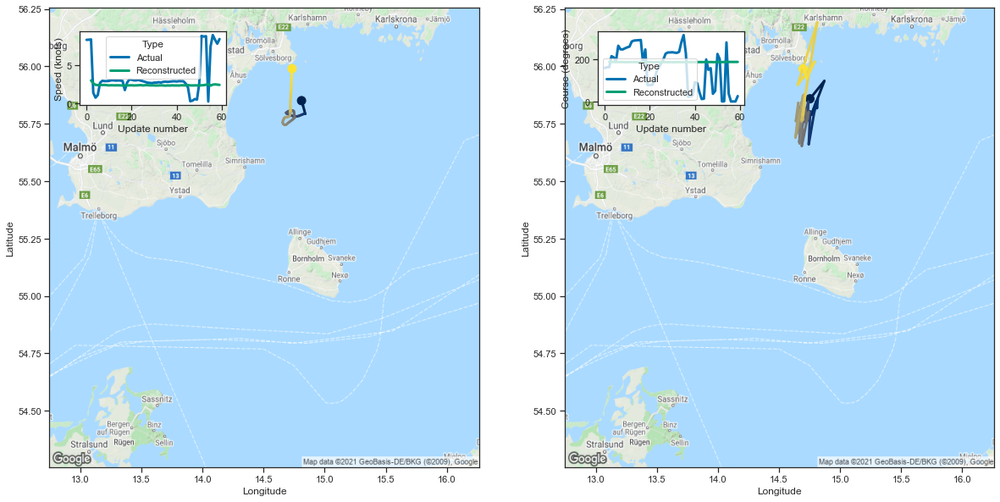

[2.9887654781341553, 2.594489812850952, 2.4077420234680176, 2.3788437843322754]


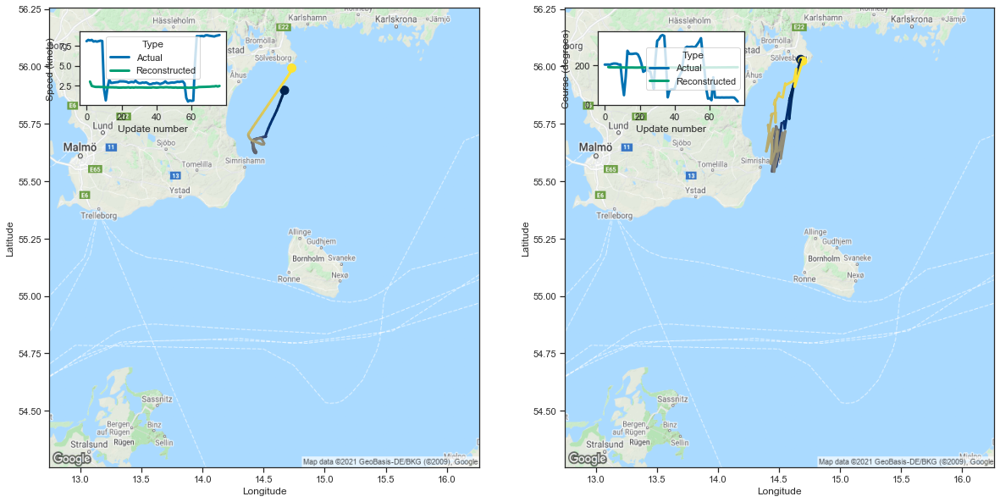

[2.998044013977051, 2.4495725631713867, 2.384809970855713, 2.331355571746826]


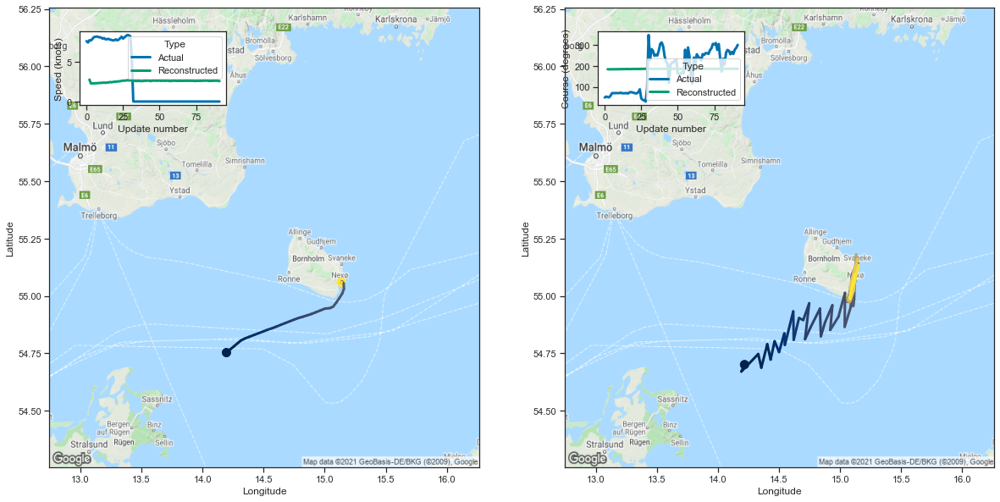

[2.777099132537842, 2.284752130508423, 2.289076089859009, 2.293267250061035]


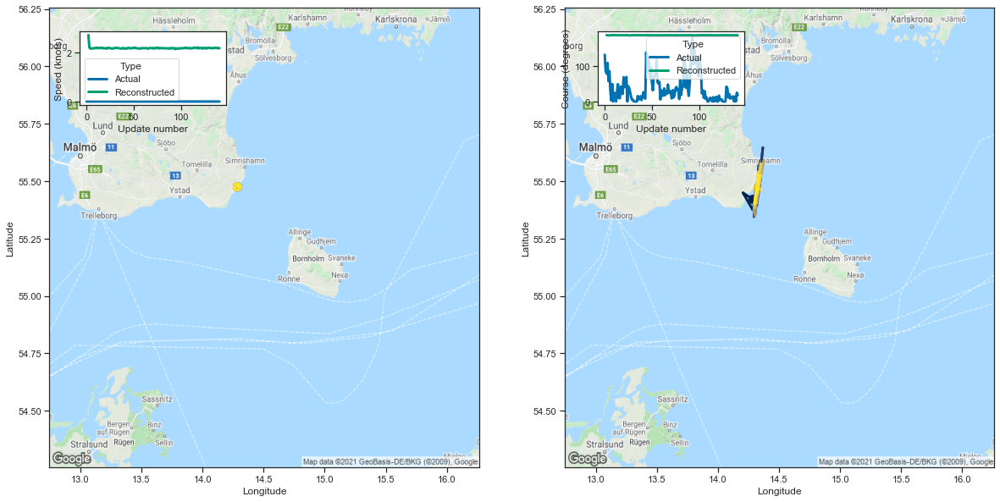

[2.7350354194641113, 2.227705240249634, 2.178030252456665, 2.1857070922851562]


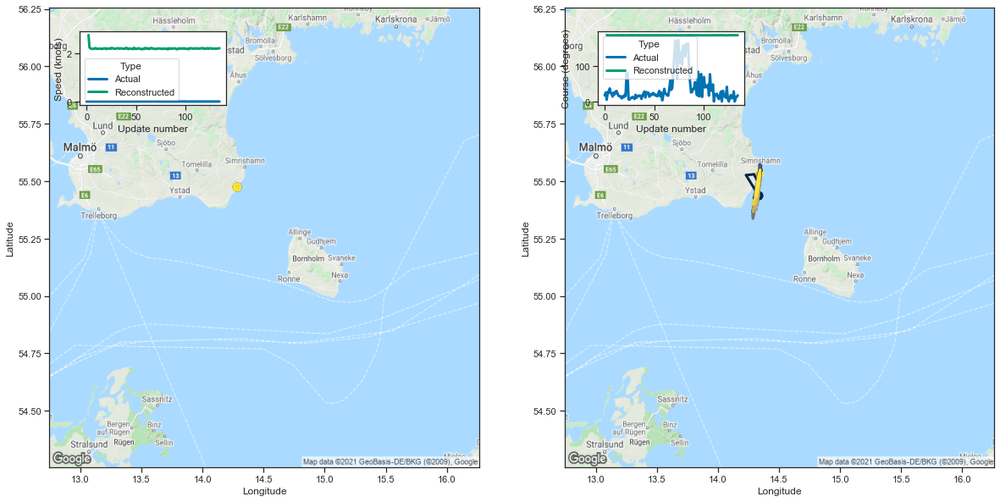

[2.7539639472961426, 2.2374351024627686, 2.198427438735962, 2.1870832443237305]


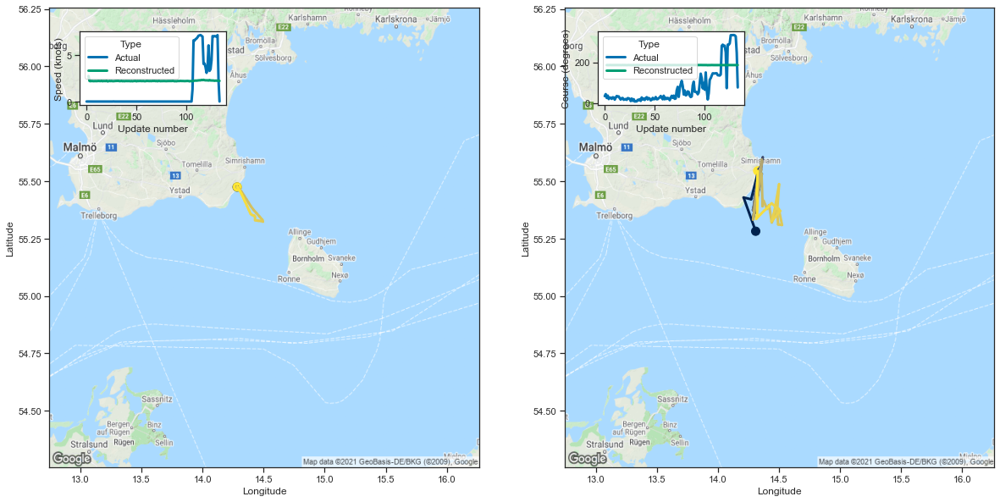

[2.73640513420105, 2.202126979827881, 2.1833925247192383, 2.2039713859558105]


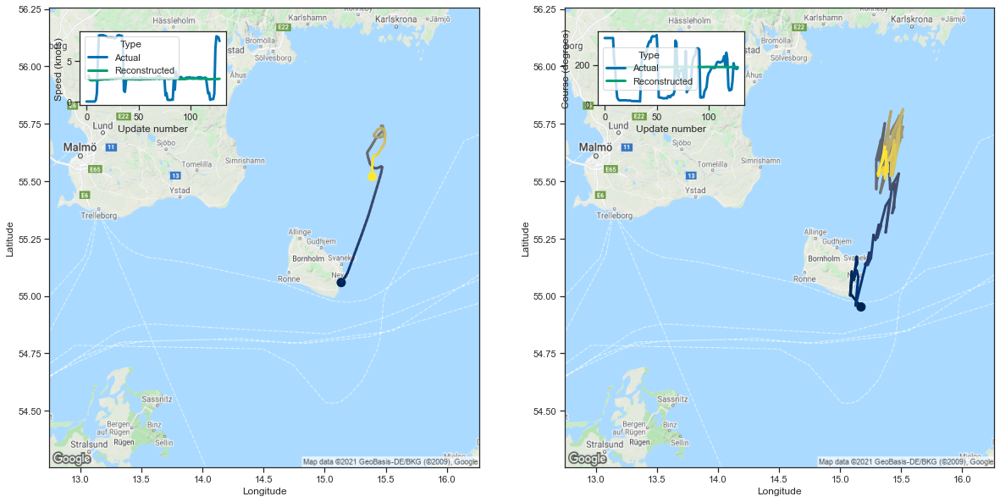

[3.175365447998047, 2.7033236026763916, 2.623271942138672, 2.6060876846313477]


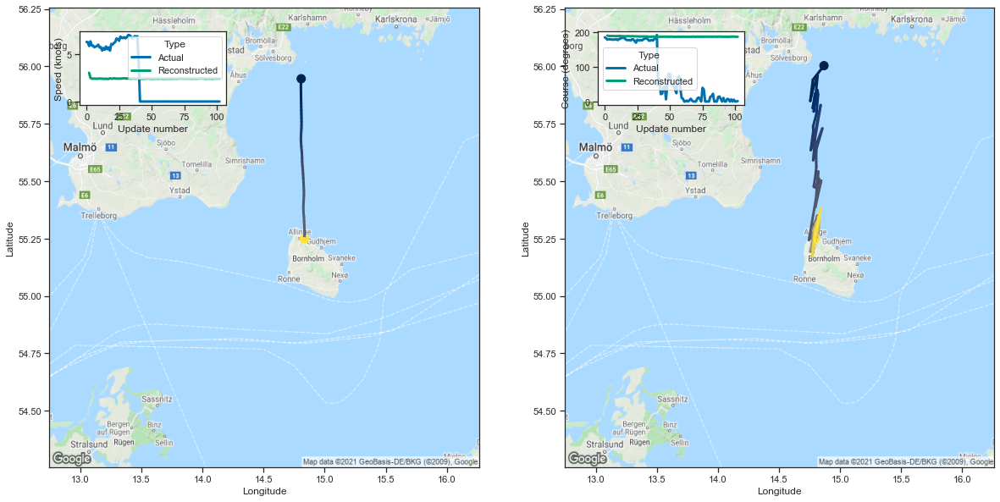

[3.0426559448242188, 2.492466926574707, 2.4237749576568604, 2.4150283336639404]


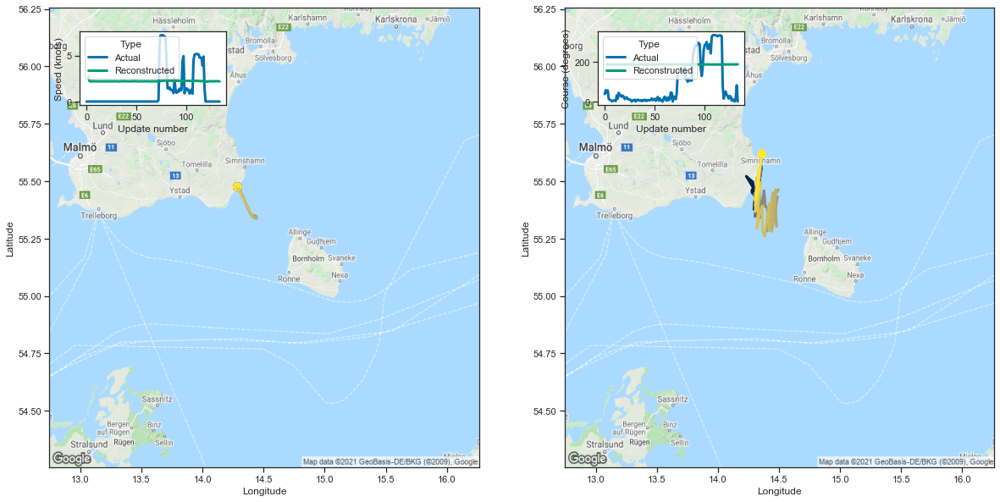

[2.7134950160980225, 2.2135863304138184, 2.1825554370880127, 2.1745645999908447]


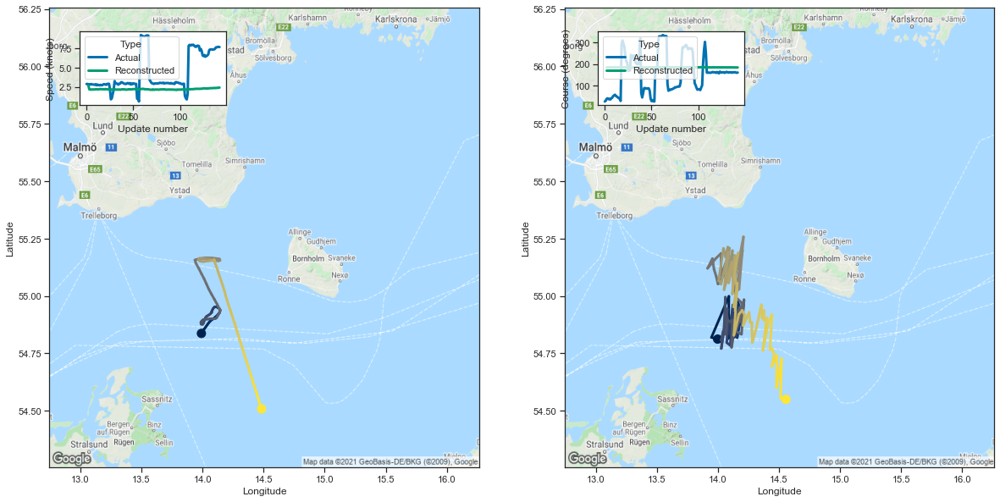

[2.670504570007324, 2.165306806564331, 2.165477991104126, 2.1327579021453857]


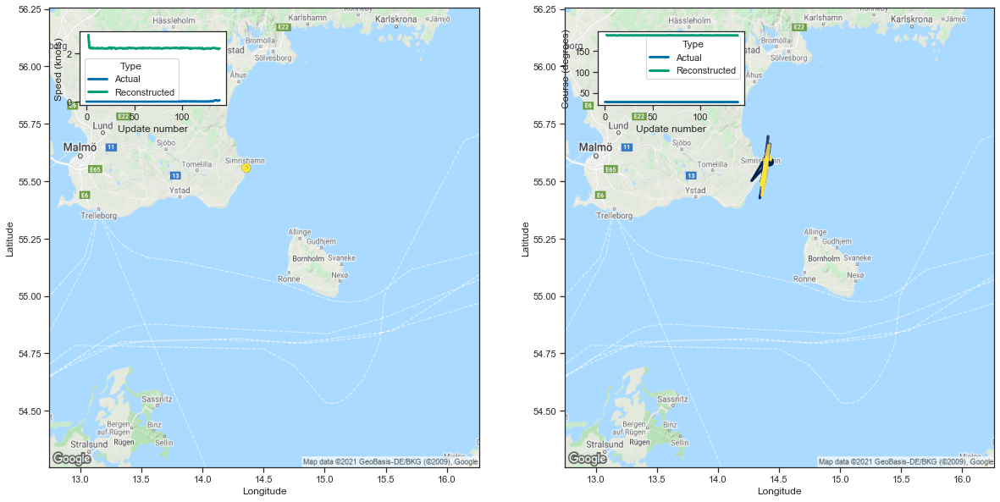

[2.762080192565918, 2.2405295372009277, 2.21100115776062, 2.230329751968384]


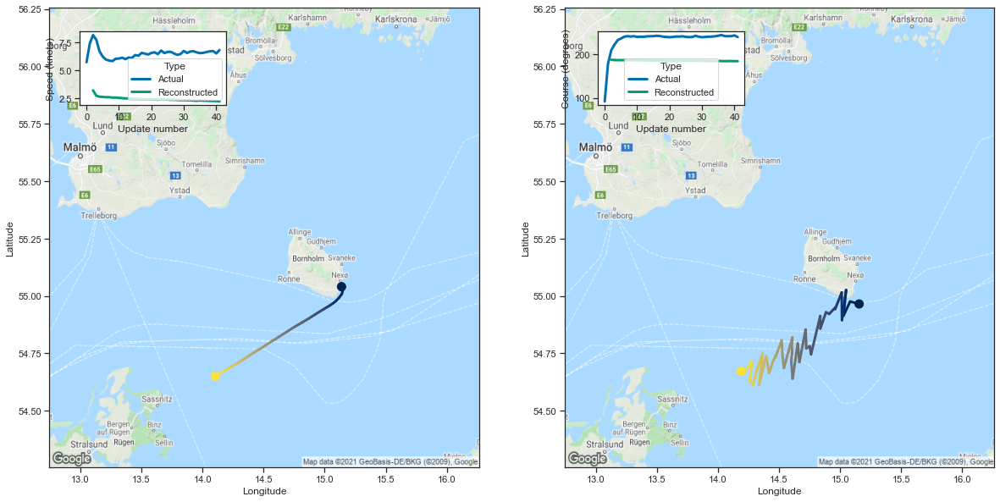

[3.2085533142089844, 2.731259346008301, 2.641226053237915, 2.6281955242156982]


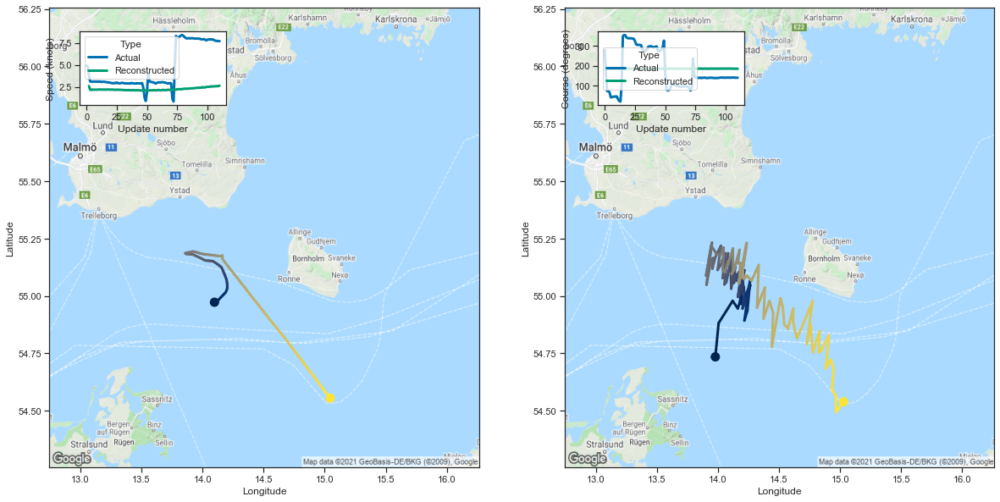

[2.6045351028442383, 2.1754653453826904, 2.1700873374938965, 2.1991937160491943]


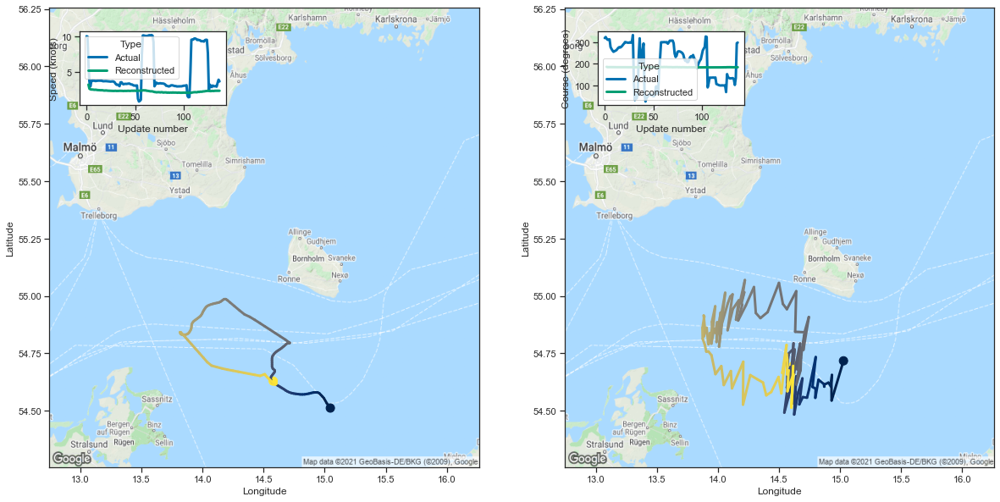

[3.2587473392486572, 2.682253360748291, 2.6025214195251465, 2.5643069744110107]


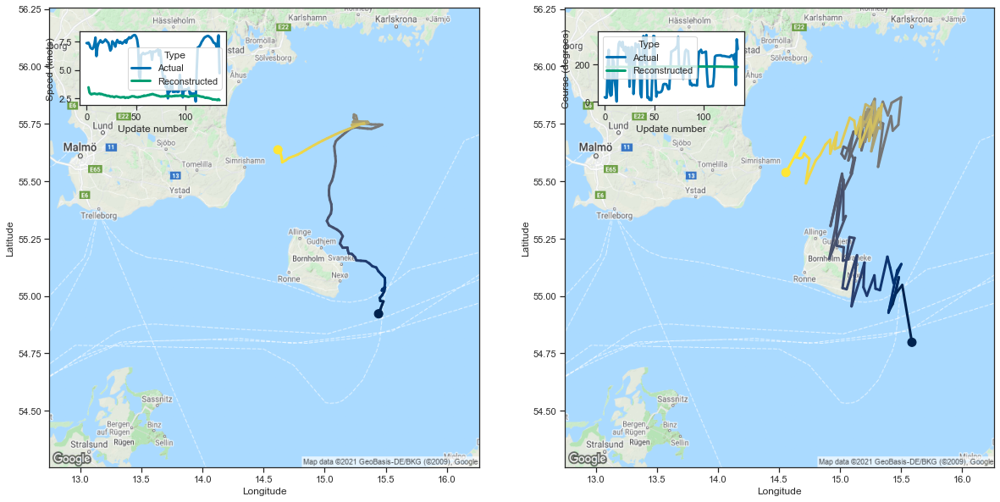

[3.4639759063720703, 3.002077102661133, 2.8882436752319336, 2.83935546875]


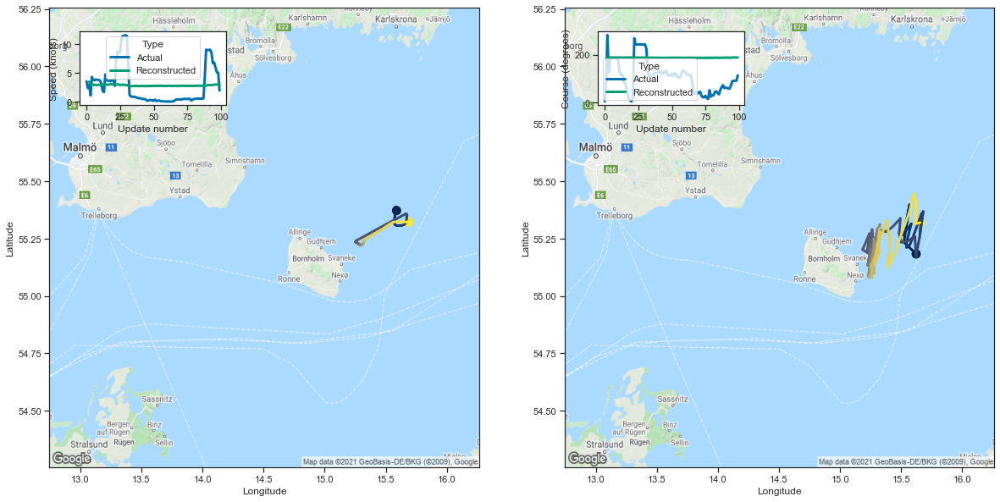

[3.4536330699920654, 2.968179225921631, 2.9294419288635254, 2.9195122718811035]


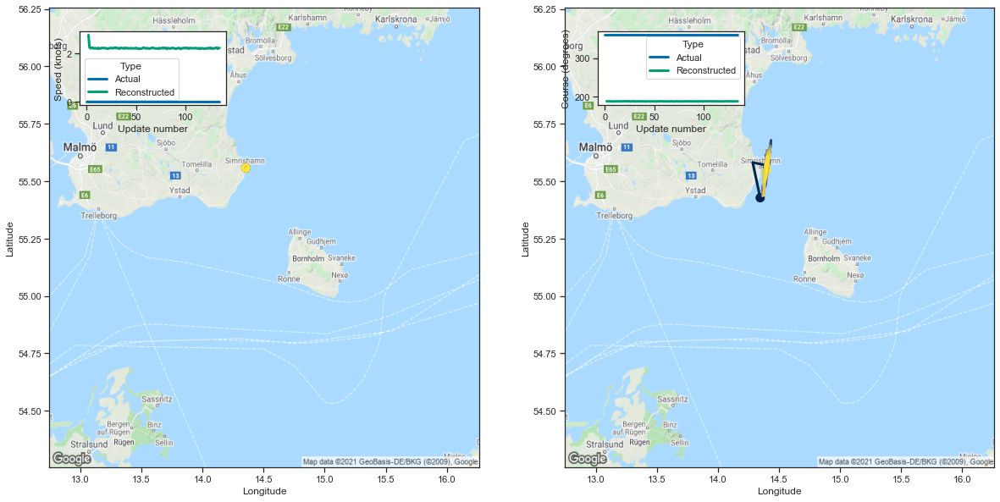

[2.766561269760132, 2.2448370456695557, 2.2140960693359375, 2.221742868423462]


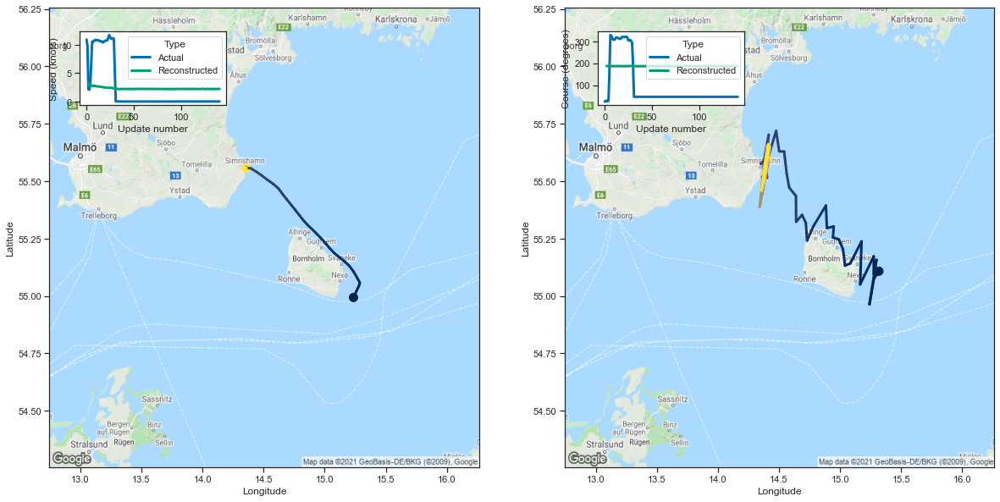

[3.319302797317505, 2.8336167335510254, 2.726909875869751, 2.769530773162842]


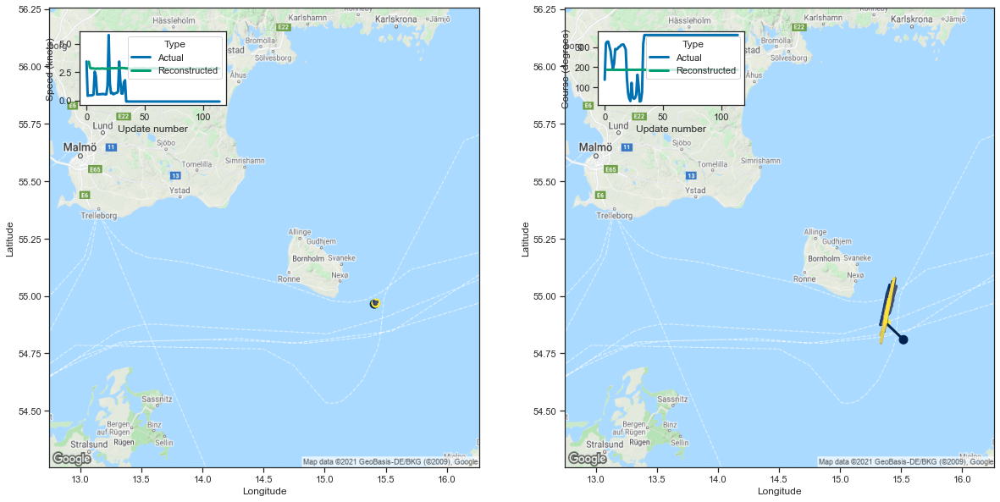

[3.4164586067199707, 2.885100841522217, 2.813019275665283, 2.830752372741699]


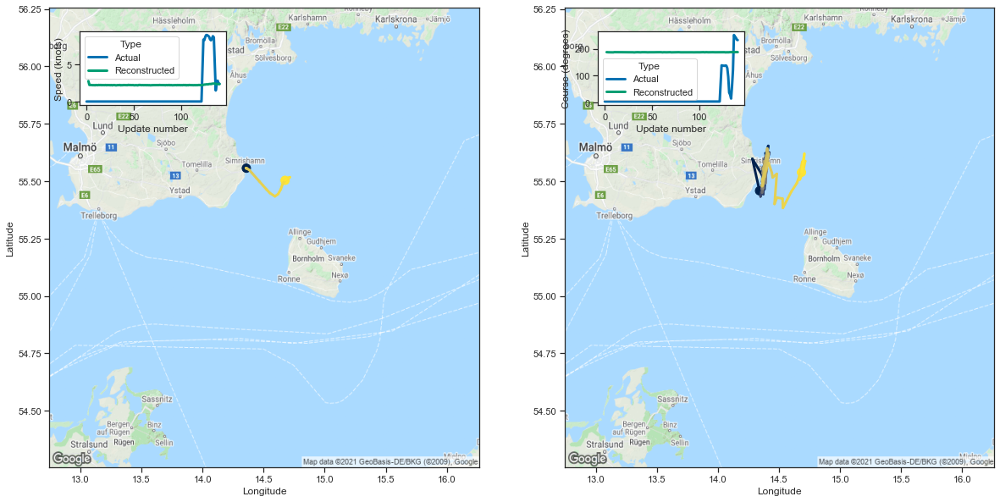

[2.758699417114258, 2.24436092376709, 2.2296621799468994, 2.2335851192474365]


,Data set Index,Index,MMSI,Ship type,Length,Reconstruction log probability,Equally weighted reconstruction log probability
8,8,1943886,230069190,Fishing,135,-738.168945,-5.467918
4,4,2259131,230069190,Fishing,141,-772.286682,-5.477211
17,17,6685896,265759000,Fishing,143,-786.828125,-5.502295
74,74,6962046,265759000,Fishing,143,-789.504272,-5.521009
29,29,6787151,265759000,Fishing,143,-794.075134,-5.552973
...,...,...,...,...,...,...,...
5,5,6496,211215500,Fishing,100,-695.294312,-6.952943
100,100,1583421,219021428,Fishing,135,-946.871399,-7.013862
23,23,5544210,265750000,Fishing,142,-1006.235046,-7.086162
56,56,4380691,261017210,Fishing,115,-818.937378,-7.121195


In [9]:
# Focus on the overall n=100 best reconstructions
data = summary_models.run_evaluation_get_n(n=100, worst=False)
df_n = data["TrajectoryLevelData"]
train_evaluate = data["TrainEvaluateObject"]

# Plot the actual and reconstructed trajectories side by side
for idx in range(100): 
    tracks = plot_actual_reconstructed(idx)
    print(list(tracks["Reconstructed trajectory"]["Speed"])[:4])
df_n